**EXP1 Predicitng Missing Cell-Types from Bulks using Non-Negative Least Squares regression Residual**

*This file includes EXP1 analysis and results. Files used were created in preprocessing/EXP1_pseudos notebook.*

**Hypothesis:**
The more celltypes are missing, the larger the residual value.
number of missing celltypes will be correlated with residual after nnls deconv.

**Summary:**
Increasing the number of missing celltypes, when all proportions are the same. then deconvolving and seeing if residual correlated with number of missing celltypes.
Using first the equal prop, then realistic (selected random).

**Deconv. Method:**
nnls

1. prop_df is the ground truth for every pseudobulks_df
2. ref_df is the reference made from the anndata object with all the expected expression for each celltype
3. Each ref_df has either 1,2,3,4,8,12 missing cell types 

In [1]:
# import the dependencies
import sys
sys.path.insert(1, '../../')
sys.path.insert(1, '../')
sys.path.insert(1, '../../../../../')

from Greene_rotation_project.sc_bulk_ood_AI.sn_sc_preprocessing import sn_sc_preprocess
from importlib import reload
reload(sn_sc_preprocess)
# general imports
import warnings
import numpy as np
from numpy import random
from numpy import array
from numpy import diag
from numpy import dot
from numpy import zeros
import pandas as pd
import scanpy as sc
from anndata import AnnData as ad
from tabulate import tabulate

import tensorflow as tf
import sklearn as sk
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import FunctionTransformer
import scipy as sp
from scipy.stats import spearmanr, pearsonr
from scipy.sparse import coo_matrix
from scipy.sparse import csr_matrix
import scipy.stats as stats
from collections import Counter
import scipy as sp
from scipy.optimize import nnls
from scipy.stats import ttest_ind

# Images, plots, display, and visualization
import matplotlib.pyplot as plt
import seaborn as sns
#sklearns
from sklearn.decomposition import FastICA
from sklearn.decomposition import NMF
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.manifold import TSNE
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import scale
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.metrics import adjusted_rand_score
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.decomposition import TruncatedSVD
from sklearn.ensemble import RandomForestClassifier

# programming stuff
import time
import os, sys
import pickle
from pathlib import Path

In [2]:
#helper function to open pseudo files and selecting some bulks depending on needs
def select_bulks(bulk_type, num_bulks_touse, num_idx_total, res_name, path):
    #selecting bulks and props for deconv.
    prop_df = pd.DataFrame()
    pseudo_df = pd.DataFrame()
    for idx in range(0,num_idx_total):
        #open each patient files:
        pseudobulk_file = os.path.join(aug_data_path, f"{res_name}_pseudo_{idx}.pkl")
        prop_file = os.path.join(aug_data_path, f"{res_name}_prop_{idx}.pkl")

        pseudobulk_path = Path(pseudobulk_file)
        prop_path = Path(prop_file)

        prop_df_new = pickle.load( open( prop_path, "rb" ) )
        pseudo_df_new = pickle.load(  open( pseudobulk_path, "rb" ) )
        
        prop_df.index = range(0,len(prop_df))
        pseudo_df.index = range(0,len(pseudo_df))

        #selecting random index withing the desired type
        index_selec = np.random.choice(bulk_range[bulk_type], num_bulks_touse)

        prop_df_new = prop_df_new.iloc[index_selec]
        pseudo_df_new = pseudo_df_new.iloc[index_selec]

        #appending    
        prop_df = prop_df.append(prop_df_new)
        pseudo_df = pseudo_df.append(pseudo_df_new)

        prop_df.index = range(0,len(prop_df))
        pseudo_df.index = range(0,len(pseudo_df))
        
    return prop_df, pseudo_df

In [3]:
#helper function to calculate nnls and residual
def calc_nnls(all_refs, prop_df, pseudo_df, num_missing_cells, cells_to_miss):
    
    calc_prop_tot = dict()
    calc_res_tot = dict()
    custom_res_tot = dict()
    comparison_prop_tot = dict()
    missing_cell_tot =dict()

    for exp in num_missing_cells:
        calc_prop_all = pd.DataFrame()
        custom_res_all = pd.DataFrame()
        calc_res_all  = pd.DataFrame()
        print(f"Exp {exp}")
        #extracting reference with missing cells 
        ref = all_refs[exp].values

        #deleting cell types from the real proportion for comparison
        if exp == 0:
            comparison_prop = prop_df
            missing_cell = []
        else:
            comparison_prop = prop_df.drop(prop_df.columns[cells_to_miss[exp]], axis=1)
            missing_cell = prop_df[prop_df.columns[cells_to_miss[exp]]]

        # calculate predicted values and residuals for each row
        for sample in range(0,len(pseudo_df)):

            #changing ref with exp in num_missing cells
            calc_prop, calc_res = nnls(ref, pseudo_df.iloc[sample].values)

            tot = np.sum(calc_prop) #putting them in proportion format
            calc_prop = calc_prop / tot

            custom_res = comparison_prop.iloc[sample].values - calc_prop

            calc_prop = pd.DataFrame(calc_prop).T
            custom_res = pd.DataFrame(custom_res).T
            
            #putting together
            calc_prop_all = pd.concat([calc_prop_all, calc_prop])
            custom_res_all = pd.concat([custom_res_all, custom_res])
            calc_res_all  = np.append(calc_res_all, calc_res)
            
        #attaching to dicts
        calc_prop_tot[exp] = calc_prop_all
        calc_res_tot[exp] = calc_res_all
        custom_res_tot[exp] = custom_res_all
        comparison_prop_tot[exp] = comparison_prop
        missing_cell_tot[exp] = missing_cell

    return calc_prop_tot, calc_res_tot, custom_res_tot, comparison_prop_tot, missing_cell_tot  

In [4]:
#####################
### set the study ###
#####################

#results paths:
res_name = "MCT_snadp_EXP1"
actual_path = os.getcwd()
path = f"{actual_path}/../../rnaseq_translator/data/adipose/GSE176171"
aug_data_path = f"{actual_path}/../data/EXP1/"

num_cells = 16

Import previously processed datasets. 

*See preprocessing/EXP1_pseudos.ipynb notebook for details.*

In [5]:
#importing adata dataframe
adata_path = os.path.join(aug_data_path, f"{res_name}_adata_df.pkl")
adata_path = Path(adata_path)
adata_df = pickle.load( open( adata_path, "rb" ) ) 

In [6]:
#and as anndata object
adata_path = os.path.join(aug_data_path, f"{res_name}_adata_notlog.h5ad")
adata_path = Path(adata_path)
adata = sc.read_h5ad(adata_path)
sn_adata = adata.copy()

In [7]:

#copy
cop_adata = sn_adata.copy()
sc.pp.log1p(cop_adata)
# get high variance genes
sc.pp.highly_variable_genes(cop_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
cop_adata = cop_adata[:, cop_adata.var.highly_variable]
gene_ids = cop_adata.var_names
#cutting sn_adata to only highly variable without log
sn_adata = sn_adata[:, cop_adata.var_names]
sn_adata

View of AnnData object with n_obs × n_vars = 122808 × 4318
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'cell_types'
    var: 'gene_ids', 'feature_types', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [8]:
# cell type order to keep it the same
cell_order = sn_adata.obs.cell_types.unique()
num_cells = len(sn_adata.obs.cell_types.unique())

In [9]:
#custom proportion of equal prop / cell
custom_prop = np.array([(1/num_cells)]*num_cells)
custom_prop  =  pd.DataFrame(custom_prop).T
custom_prop.columns = cell_order
custom_prop

,preadipocyte,mesothelial cell,pericyte cell,fat cell,macrophage,endothelial cell,endothelial cell of lymphatic vessel,T cell,dendritic cell,smooth muscle cell,B cell,mast cell,monocyte,immature NK T cell,stromal cell of endometrium,neutrophil
0,0.0625,0.0625,0.0625,0.0625,0.0625,0.0625,0.0625,0.0625,0.0625,0.0625,0.0625,0.0625,0.0625,0.0625,0.0625,0.0625


Randomly selecting cells to delete:

In [10]:
choice_cell_tomiss = False #in case you want to select which cells to delete

num_missing_cells = [0,1,2,3,4,8,12] #select number of missing cells

cells_to_choose = np.array(range(0,len(cell_order)))
cells_to_miss = dict()
cells_to_miss[0] = np.array([])
past_miss = cells_to_miss[0]

cells_to_miss[num_missing_cells[-1:][0]] = np.random.choice(cells_to_choose,
                                 num_missing_cells[-1:][0] , replace=False)

In [11]:
cells_to_miss[1] = np.random.choice(cells_to_choose, 1, replace=False)
cells_to_choose = np.delete(cells_to_choose, cells_to_miss[1])
new_rand = np.random.choice(cells_to_choose, 1, replace=False)
cells_to_miss[2] = np.append(cells_to_miss[1], new_rand)
cells_to_choose = np.delete(cells_to_choose, cells_to_choose == new_rand)

In [12]:
new_rand = np.random.choice(cells_to_choose, 1, replace=False)
cells_to_miss[3] = np.append(cells_to_miss[2], new_rand)
cells_to_choose = np.delete(cells_to_choose, cells_to_choose == new_rand)

In [13]:
new_rand = np.random.choice(cells_to_choose, 1, replace=False)
cells_to_miss[4] = np.append(cells_to_miss[3], new_rand)
cells_to_choose = np.delete(cells_to_choose, cells_to_choose == new_rand)

In [14]:
new_rand = np.random.choice(cells_to_choose, 4, replace=False)
cells_to_miss[8] = np.append(cells_to_miss[4], new_rand)
for num in range(0,len(new_rand)):
    cells_to_choose = np.delete(cells_to_choose, cells_to_choose == new_rand[num])

In [15]:
new_rand = np.random.choice(cells_to_choose, 4, replace=False)
cells_to_miss[12] = np.append(cells_to_miss[8], new_rand)
for num in range(0,len(new_rand)):
    cells_to_choose = np.delete(cells_to_choose, cells_to_choose == new_rand[num])

In [16]:
changing_order = cells_to_miss[12]
cells_to_miss.pop(12)
cells_to_miss[12] = changing_order
cells_to_miss

{0: array([], dtype=float64),
 1: array([1]),
 2: array([1, 8]),
 3: array([ 1,  8, 10]),
 4: array([ 1,  8, 10,  2]),
 8: array([ 1,  8, 10,  2,  5, 11,  0, 12]),
 12: array([ 1,  8, 10,  2,  5, 11,  0, 12,  4, 15, 14,  7])}

**Deconvolution using NNLS**

Creating reference profile:

In [17]:
cell_types = sn_adata.obs["cell_types"].unique()
gene_ids = sn_adata.var["gene_ids"]
ref_df = pd.DataFrame(index = gene_ids, columns = cell_types)
# #logging first:
sc.pp.log1p(sn_adata, base = 10)
num_samples = 15000

for cell_type in cell_types:
    
    cell_df = sn_adata[sn_adata.obs["cell_types"].isin([cell_type])]

    cell_sample = sk.utils.resample(cell_df, n_samples = num_samples, replace=True)
    x = cell_sample.X.sum(axis=0)
    sum_over_genes = pd.DataFrame(x).T

    #and save to df dict
    ref_df[cell_type] = sum_over_genes.values
ref_df

/beevol/home/ivicha/miniconda3/envs/env_ml/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:373: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


,preadipocyte,mesothelial cell,pericyte cell,fat cell,macrophage,endothelial cell,endothelial cell of lymphatic vessel,T cell,dendritic cell,smooth muscle cell,B cell,mast cell,monocyte,immature NK T cell,stromal cell of endometrium,neutrophil
gene_ids,,,,,,,,,,,,,,,,
A2M,1799.587158,1469.767090,7606.729980,1410.376343,5368.938477,10510.489258,3137.867676,7139.245117,4778.585938,7823.691406,1991.218750,9708.797852,1671.618042,5996.726562,2051.788330,1749.101196
A2M-AS1,93.306282,55.389816,60.193840,155.016174,77.294724,251.680573,138.913651,1428.207397,87.079659,100.315208,181.304276,2570.629395,49.169834,1210.393921,53.776230,0.000000
A2ML1,131.295242,49.951740,86.405640,102.395203,84.305214,50.883198,15.114676,18.665119,67.983055,110.752502,30.470552,21.785101,132.284912,25.669819,120.161072,0.000000
AADACL2-AS1,743.942078,641.979675,579.708130,66.645874,876.298767,165.762924,155.341568,68.836311,270.486176,94.475258,46.703766,112.274643,46.388405,115.657471,467.607819,0.000000
AADACL4,147.770660,6.465552,4.917887,2.381734,1.586470,2.808481,0.838770,4.847827,0.000000,3.820933,0.000000,14.410985,0.000000,0.000000,33.439041,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CCL4L2,13.181171,8.387173,24.331888,13.335395,179.467255,19.743643,6.117694,186.123138,111.016541,27.734638,0.000000,198.552597,73.920097,611.208557,0.000000,0.000000
CXCL8,17.075460,5.944596,9.148832,10.558674,130.978592,22.477331,11.403570,32.164738,273.897552,15.978854,0.000000,33.766296,32.103802,31.306553,0.000000,0.000000
IGHA1,30.793251,20.884939,28.493311,10.663734,25.662996,34.509617,9.071819,18.256001,4.008319,28.053585,1528.960693,36.301365,18.895800,59.121178,35.862335,0.000000


In [18]:
# ref_df = ref_df + 1
# ref_df = ref_df.applymap(np.log10)
# ref_df

Importing pseudobulk and proportion files:

In [19]:
#each pseudo file has:
## realisitc*200, cell_type_specific*1000*, random*200, equal*200
#so here we're defining the ranges to extract the bulks of choice.
bulk_range = dict()
num_cells = 16
bulk_range["realistic"] = range(0,200)
bulk_range["cell_type_specific"] = range(200,(50*num_cells)+200) #1000
bulk_range["random"] = range((50*num_cells)+200,(50*num_cells)+400) #1200
bulk_range["equal"] = range((50*num_cells)+400,(50*num_cells)+600) #1400

In [20]:
##select_bulks(bulk_type, num_bulks_touse, num_idx_total, res_name, path)
prop_df, pseudo_df = select_bulks('random', 100, 10, res_name, aug_data_path)
pseudo_df

gene_ids,A1BG,A1BG-AS1,A1CF,A2M,A2M-AS1,A2ML1,A2ML1-AS1,A3GALT2,A4GALT,A4GNT,...,HIST1H3I,LINC01972,LINC02393,NCCRP1,PAEP,PLA2G1B,SERPINB13,SLC17A2,TBC1D3B,Z82186.1
0,245,559,55,3527,77,36,1384,4,841,0,...,0,0,0,0,0,0,0,0,0,0
1,100,471,12,2710,90,49,821,1,354,0,...,0,0,0,0,0,0,0,0,0,0
2,42,150,118,1216,91,45,957,3,98,8,...,0,0,0,0,0,0,0,0,0,0
3,198,481,53,2511,41,67,1031,2,497,1,...,0,0,0,0,3,0,0,0,0,0
4,129,306,20,2107,52,44,746,4,458,5,...,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,104,421,4,800,252,65,1311,107,34,0,...,0,0,0,0,0,0,0,0,0,0
996,53,222,29,468,201,46,1969,117,24,32,...,0,0,0,0,0,0,0,0,0,0
997,94,634,3,812,1056,40,836,7,19,0,...,0,0,0,0,1,0,0,0,0,0
998,133,242,9,423,141,54,1955,123,98,25,...,0,0,0,0,8,0,0,0,0,0


In [21]:
gene_ids = sn_adata.var_names
pseudo_df  = pseudo_df[gene_ids]
pseudo_df

gene_ids,A2M,A2M-AS1,A2ML1,AADACL2-AS1,AADACL4,AATK,ABCA10,ABCA4,ABCA6,ABCA8,...,ZSCAN1,ZSCAN31,ZSWIM4,ZSWIM5,C2CD4B,CCL4L2,CXCL8,IGHA1,AC139722.1,AQP4
0,3527,77,36,142,6,100,1068,1737,4326,552,...,62,321,218,3894,37,155,34,7,5,4
1,2710,90,49,218,3,157,752,630,6428,677,...,27,351,171,1666,23,150,110,33,8,1
2,1216,91,45,105,4,134,1927,88,4681,1563,...,12,372,115,923,7,131,14,0,6,42
3,2511,41,67,239,7,58,1072,1744,5410,1019,...,80,470,170,3005,23,39,9,11,2,0
4,2107,52,44,215,21,121,1379,834,5507,1213,...,49,444,155,2774,27,115,67,7,6,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,800,252,65,18,14,358,4468,16,625,1229,...,32,59,3530,326,61,51,17,34,35,5
996,468,201,46,14,11,79,11886,34,874,2571,...,36,62,3096,430,19,29,6,9,32,130
997,812,1056,40,12,6,293,3313,29,485,839,...,19,21,2851,492,11,73,3,162,73,6
998,423,141,54,68,149,89,26244,16,1985,6222,...,11,108,3608,564,3,25,13,17,110,29


In [22]:
pseudo_df_real = prop_df @ ref_df.T
pseudo_df_real = pd.DataFrame(pseudo_df_real)
pseudo_df_real

gene_ids,A2M,A2M-AS1,A2ML1,AADACL2-AS1,AADACL4,AATK,ABCA10,ABCA4,ABCA6,ABCA8,...,ZSCAN1,ZSCAN31,ZSWIM4,ZSWIM5,C2CD4B,CCL4L2,CXCL8,IGHA1,AC139722.1,AQP4
0,5166.842393,234.659777,61.033525,135.301116,2.686671,66.303781,1864.76052,487.137905,2138.605,1656.316705,...,96.612186,302.581073,452.348569,1858.979395,45.494338,38.347091,33.948419,33.3016,8.423951,19.958585
1,4975.412234,284.065579,58.542681,321.625315,5.384679,113.805484,1667.786245,187.92826,4446.357912,1610.892451,...,49.006086,363.210383,411.977317,956.75311,58.722115,80.232718,45.267783,339.665335,29.257808,10.8912
2,2500.372951,348.467922,81.568489,151.267321,14.073465,171.06048,4841.105672,29.722713,4350.01979,4680.687437,...,12.438881,437.430967,283.905814,917.693348,6.301871,88.195941,17.508391,20.317084,30.534868,125.898029
3,4972.1689,132.867936,58.063764,369.442425,5.613327,42.170215,1854.324193,522.243206,3295.616261,3087.338506,...,130.194984,397.392942,476.395942,1734.735776,42.550911,27.394958,15.768534,52.185462,7.964231,3.102375
4,4302.481086,255.17174,72.271422,298.871027,27.407901,84.707158,3814.671037,319.72771,4204.660567,3534.048296,...,81.617142,472.884195,443.89485,1509.273936,48.959956,63.814385,23.234297,47.568,24.720509,20.680468
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,4429.97683,165.567627,94.946073,280.016322,13.178396,203.701089,2167.728496,67.382894,4148.574412,2093.956952,...,42.418939,417.066409,404.120587,741.313213,66.137294,66.704028,40.67086,61.724492,21.089604,10.469933
996,2405.749407,169.223279,100.1038,235.025827,24.458755,37.252992,5707.211995,73.828785,5646.713564,5504.826776,...,23.359195,459.175777,336.778959,1054.238083,11.673959,29.50528,21.810285,18.356285,20.54457,131.44735
997,4856.807785,690.003073,45.514287,222.133402,4.512816,138.978857,1603.464838,62.506434,3430.579209,1511.966997,...,16.095132,216.830769,342.077082,996.19687,14.370684,108.964351,42.888192,325.777033,47.006777,8.204403
998,1884.45006,99.661728,124.732283,712.232011,134.417632,23.977404,12970.420689,32.455382,12511.024509,10885.271881,...,21.330873,731.726729,362.810359,1131.348706,8.48125,15.844935,20.038499,45.876643,92.576842,18.011707


Normalize both:

In [ ]:
# pseudo_df_real = pseudo_df_real + 1
# pseudo_df_real = pseudo_df_real.applymap(np.log10)
# pseudo_df_real

In [ ]:
all_prop_refs = dict()
#with no cell missing is just ref_df
all_prop_refs[0] = prop_df
#assigning the rest in a loop
for num in num_missing_cells[1:]:
    all_prop_refs[num] = prop_df.drop(prop_df.columns[cells_to_miss[num]], axis=1) 

In [ ]:
all_refs = dict()
all_prop_refs = dict()
#with no cell missing is just ref_df
all_refs[0] = ref_df
all_prop_refs[0] = prop_df
#assigning the rest in a loop
for num in num_missing_cells[1:]:
    all_refs[num] = ref_df.drop(ref_df.columns[cells_to_miss[num]], axis=1)
    all_prop_refs[num] = prop_df.drop(prop_df.columns[cells_to_miss[num]], axis=1) 

NNLS Deconvolution:

In [ ]:
calc_prop_tot, calc_res_tot, custom_res_tot, comparison_prop_tot, missing_cell_tot  = calc_nnls(all_refs, prop_df, pseudo_df_real, num_missing_cells, cells_to_miss)

Exp 0
Exp 1
Exp 2
Exp 3
Exp 4
Exp 8
Exp 12


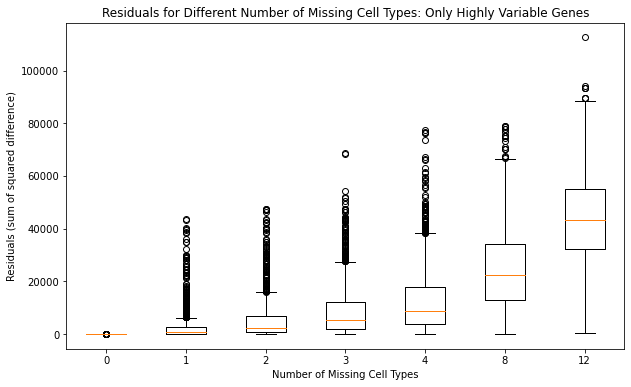

In [ ]:
#initializing results plotting
residuals = [calc_res_tot[exp] for exp in num_missing_cells]

plt.figure(figsize=(10, 6))
plt.boxplot(residuals, labels=num_missing_cells)
plt.xlabel('Number of Missing Cell Types')
plt.ylabel('Residuals (sum of squared difference)')
plt.title('Residuals for Different Number of Missing Cell Types: Only Highly Variable Genes')
## nnls(A, b)
##/Ax -b/^2
plt.show()

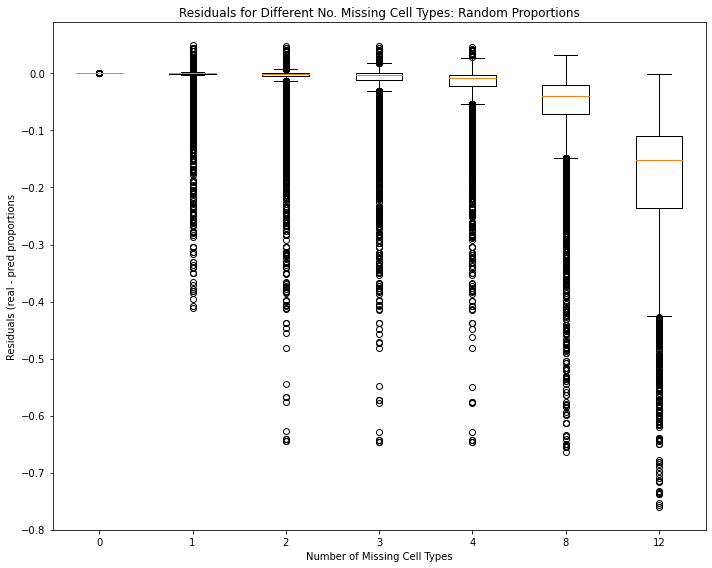

In [ ]:
# List of numbers representing missing cell types
num_cells_missing = [0, 1, 2, 3, 4, 8, 12]

# Plotting box and whisker plots
fig, ax = plt.subplots(figsize=(10, 8))

# List to store all the residual values
residual_values = []

# Iterate over the dataframes and extract the residual values
for num_cells in num_cells_missing:
    df = custom_res_tot[num_cells]
    residuals = df.values.flatten()  # Flatten the dataframe to a 1D array
    residual_values.append(residuals)

# Plot the box and whisker plot for all the residuals
ax.boxplot(residual_values, labels=num_cells_missing)
ax.set_title("Residuals for Different No. Missing Cell Types: Random Proportions")
ax.set_xlabel("Number of Missing Cell Types")
ax.set_ylabel("Residuals (real - pred proportions")

plt.tight_layout()
plt.show()

In [ ]:
#matching columns and index to keep track
for num in num_missing_cells:
    calc_prop_tot[num].columns = all_refs[num].columns
    calc_prop_tot[num].index = range(0,len(calc_prop_tot[num]))
calc_prop_tot[0] 

,preadipocyte,mesothelial cell,pericyte cell,fat cell,macrophage,endothelial cell,endothelial cell of lymphatic vessel,T cell,dendritic cell,smooth muscle cell,B cell,mast cell,monocyte,immature NK T cell,stromal cell of endometrium,neutrophil
0,0.0622,0.0432,0.0226,0.1406,0.0662,0.0160,0.0202,0.0898,3.320000e-02,0.0486,0.0118,0.0652,0.2946,3.360000e-02,0.0018,0.0504
1,0.0212,0.0244,0.0624,0.1524,0.0228,0.2468,0.0534,0.0158,2.162000e-01,0.0612,0.0790,0.0030,0.0092,1.400000e-02,0.0048,0.0134
2,0.0054,0.0088,0.0052,0.0158,0.2244,0.0262,0.0044,0.0004,3.050000e-01,0.0604,0.0008,0.0104,0.0276,4.200000e-03,0.2138,0.0872
3,0.1506,0.0158,0.0428,0.0644,0.0234,0.0814,0.2350,0.0438,2.160000e-02,0.0918,0.0154,0.0072,0.0332,5.820000e-02,0.1064,0.0090
4,0.2260,0.0022,0.0632,0.2172,0.0250,0.0720,0.2098,0.0024,2.980000e-02,0.0044,0.0050,0.0014,0.1244,1.115019e-17,0.0006,0.0166
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.0042,0.0128,0.0212,0.0028,0.0074,0.0218,0.0122,0.5054,1.214288e-17,0.2418,0.0276,0.0216,0.0002,2.000000e-04,0.0002,0.1206
996,0.0950,0.0492,0.1248,0.0078,0.0788,0.0304,0.0192,0.0320,1.156000e-01,0.0190,0.0052,0.0122,0.3184,2.180000e-02,0.0082,0.0624
997,0.0034,0.0048,0.0186,0.0278,0.0308,0.0032,0.0038,0.0002,2.400000e-03,0.0018,0.0206,0.0576,0.0036,0.000000e+00,0.0072,0.8142
998,0.1032,0.1388,0.0016,0.0004,0.0006,0.0040,0.0000,0.0014,8.000000e-04,0.1858,0.0254,0.4178,0.0342,1.000000e-03,0.0834,0.0016


In [ ]:
#recreate matrix with calculated proportion nnls and multiplying by the real reference
recreated_mat_all = dict()
for num in num_missing_cells:
        recreated_mat_all[num] = pd.DataFrame(all_refs[num] @ calc_prop_tot[num].T)
        recreated_mat_all[num] = recreated_mat_all[num].T
        recreated_mat_all[num].columns = gene_ids
recreated_mat_all[0]      

,A2M,A2M-AS1,A2ML1,AADACL2-AS1,AADACL4,AATK,ABCA10,ABCA4,ABCA6,ABCA8,...,ZSCAN1,ZSCAN31,ZSWIM4,ZSWIM5,C2CD4B,CCL4L2,CXCL8,IGHA1,AC139722.1,AQP4
0,3744.063905,406.406921,88.880099,197.922945,11.535911,203.726063,2760.812901,47.134379,3806.246073,2733.628945,...,18.992322,338.543252,319.391090,822.418224,18.690755,91.336505,35.083968,37.272180,44.291212,35.711151
1,5529.405734,186.172667,73.139361,223.618897,5.068373,139.438016,2247.679315,95.799189,3670.843507,2380.273927,...,50.229978,499.325221,460.106104,993.393010,70.689926,58.417605,67.417199,131.353135,10.915789,45.645785
2,4294.792146,116.378868,85.896850,392.438348,8.065347,203.272073,1733.762118,14.983676,5989.274379,2169.637964,...,30.186959,331.188307,495.977818,660.587439,23.436023,89.842050,105.234076,16.682619,8.092709,20.799019
3,4290.231402,253.320062,75.982847,295.813263,27.225870,85.443766,3820.867576,320.015653,4197.549118,3531.120932,...,80.892635,471.377952,442.772529,1505.124103,45.906896,66.121698,21.008826,43.275795,24.780814,22.301149
4,3201.801896,119.198158,88.507344,295.096640,33.761033,109.250665,5156.165166,291.626220,5533.848663,4677.860733,...,65.077935,458.989771,378.053551,1282.523894,40.736490,30.071340,25.142009,25.527416,28.763363,54.230442
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,6436.728719,825.025099,48.632712,105.641189,8.580769,229.020224,1667.713963,34.125681,1745.628295,1492.435462,...,22.000796,231.802559,335.136787,1415.674926,12.496487,110.333720,15.617014,56.860453,18.324393,7.300673
996,3864.482544,173.419765,97.028972,303.088847,15.446650,231.407581,2660.640725,42.565924,4704.771216,3002.750994,...,30.577111,361.852074,361.799426,725.263377,23.261497,79.724547,55.040205,28.762715,21.106397,10.927944
997,2486.031565,162.291617,11.390131,55.117961,1.576726,1187.341669,2335.279001,8.807977,2554.210953,1681.161161,...,5.877562,191.014189,218.216008,322.990064,2.299165,17.634038,6.903831,34.050816,29.115242,7.437169
998,6166.775524,1119.964516,63.522349,252.696350,23.776350,86.438732,3067.993230,25.765294,2904.430785,3109.338474,...,35.854763,541.306024,402.637283,982.705717,9.218199,90.069445,19.996956,68.168449,217.374497,8.079189


In [ ]:
residuals_realgt = dict()
for num in num_missing_cells:
    res =( all_refs[num] @ all_prop_refs[num].T).T - ( all_refs[num] @ calc_prop_tot[num].T).T
    # res =  np.abs(res)
    residuals_realgt[num] = pd.DataFrame(res, columns = gene_ids)
residuals_realgt[0]    

,A2M,A2M-AS1,A2ML1,AADACL2-AS1,AADACL4,AATK,ABCA10,ABCA4,ABCA6,ABCA8,...,ZSCAN1,ZSCAN31,ZSWIM4,ZSWIM5,C2CD4B,CCL4L2,CXCL8,IGHA1,AC139722.1,AQP4
0,0.0,-0.0,0.0,-0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,...,-0.0,-0.0,-0.0,-0.0,0.0,0.0,0.0,-0.0,-0.0,-0.0
1,-0.0,-0.0,0.0,0.0,-0.0,-0.0,0.0,0.0,0.0,0.0,...,-0.0,-0.0,-0.0,-0.0,-0.0,0.0,0.0,-0.0,-0.0,0.0
2,-0.0,-0.0,0.0,-0.0,0.0,0.0,0.0,0.0,-0.0,0.0,...,0.0,0.0,-0.0,0.0,0.0,-0.0,-0.0,0.0,-0.0,-0.0
3,0.0,0.0,-0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,-0.0,0.0,-0.0,0.0,0.0,...,0.0,0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,-0.0,-0.0,0.0,0.0,0.0,-0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,-0.0,-0.0,0.0,-0.0,0.0
996,0.0,0.0,0.0,-0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,...,-0.0,-0.0,-0.0,-0.0,0.0,0.0,0.0,-0.0,-0.0,-0.0
997,-0.0,-0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,0.0
998,0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,0.0,-0.0,-0.0,...,0.0,-0.0,0.0,0.0,0.0,-0.0,-0.0,0.0,-0.0,-0.0


In [ ]:
residuals = dict()
for num in num_missing_cells:
    res = pseudo_df_real.values - recreated_mat_all[num].values
    # res =  np.abs(res)
    residuals[num] = pd.DataFrame(res, columns = gene_ids)
residuals[0]    

,A2M,A2M-AS1,A2ML1,AADACL2-AS1,AADACL4,AATK,ABCA10,ABCA4,ABCA6,ABCA8,...,ZSCAN1,ZSCAN31,ZSWIM4,ZSWIM5,C2CD4B,CCL4L2,CXCL8,IGHA1,AC139722.1,AQP4
0,0.0,-0.0,0.0,-0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,...,-0.0,-0.0,-0.0,-0.0,0.0,0.0,0.0,-0.0,-0.0,-0.0
1,-0.0,-0.0,0.0,0.0,-0.0,-0.0,0.0,0.0,0.0,0.0,...,-0.0,-0.0,-0.0,-0.0,-0.0,0.0,0.0,-0.0,-0.0,0.0
2,-0.0,-0.0,0.0,-0.0,0.0,0.0,0.0,0.0,-0.0,0.0,...,0.0,0.0,-0.0,0.0,0.0,-0.0,-0.0,0.0,-0.0,-0.0
3,0.0,0.0,-0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,-0.0,0.0,-0.0,0.0,0.0,...,0.0,0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,-0.0,-0.0,0.0,0.0,0.0,-0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,-0.0,-0.0,0.0,-0.0,0.0
996,0.0,0.0,0.0,-0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,...,-0.0,-0.0,-0.0,-0.0,0.0,0.0,0.0,-0.0,-0.0,-0.0
997,-0.0,-0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,0.0
998,0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,0.0,-0.0,-0.0,...,0.0,-0.0,0.0,0.0,0.0,-0.0,-0.0,0.0,-0.0,-0.0


Evalutating NNLS Performance:

In [ ]:
print(residuals[0]['A2M-AS1'].mean())
print(recreated_mat_all[0]['A2M-AS1'].mean())
print(pseudo_df_real['A2M-AS1'].mean())
print(residuals_realgt[0]['A2M-AS1'].mean())

-4.9411141844757365e-14
424.86911080871283
424.86911080871306
-4.9411141844757365e-14


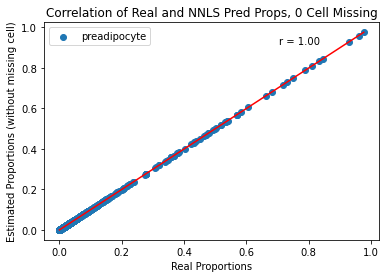

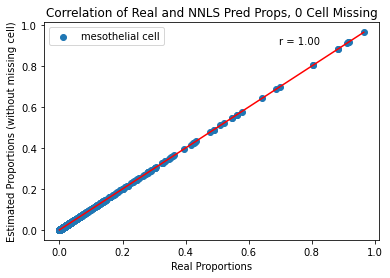

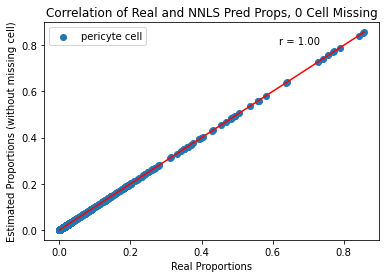

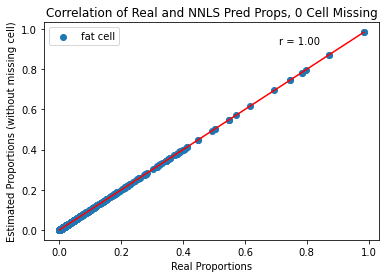

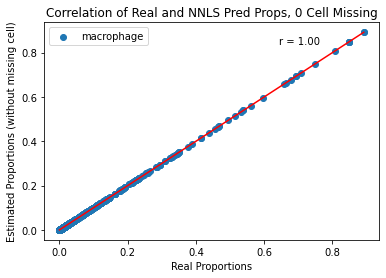

...

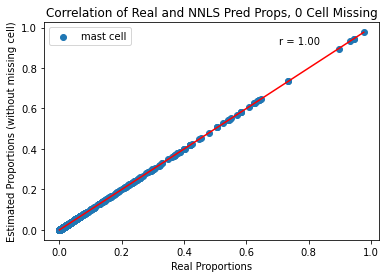

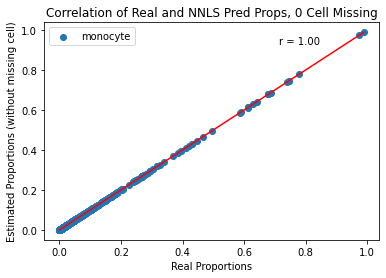

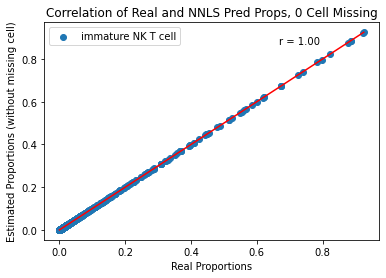

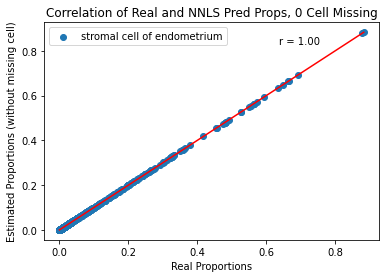

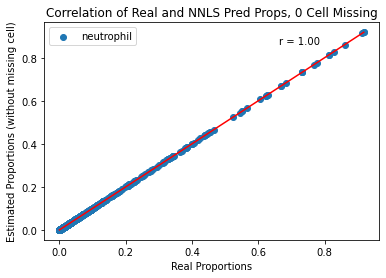

In [ ]:
num = 0
for col_cell in all_prop_refs[num].columns:
    x = all_prop_refs[num][col_cell].values.astype(float)
    y = calc_prop_tot[num][col_cell].values.astype(float)
    correlation_coefficient = np.corrcoef(x, y)[0,1]
    plt.scatter(x, y, label= f"{col_cell}")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
    plt.xlabel('Real Proportions')
    plt.ylabel('Estimated Proportions (without missing cell)')
    plt.title(f'Correlation of Real and NNLS Pred Props, {num} Cell Missing')
    plt.legend()
    plt.show()

Real Proportions shape: (16000,)
Estimated Proportions shape: (16000,)


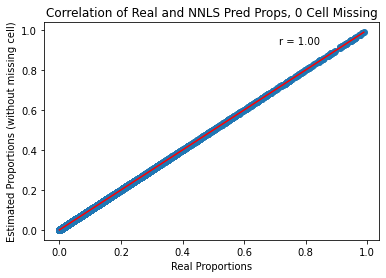

Real Proportions shape: (15000,)
Estimated Proportions shape: (15000,)


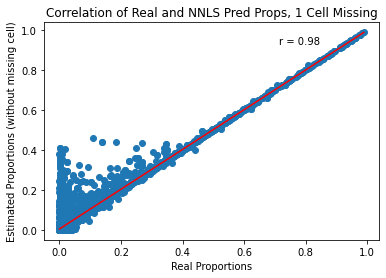

Real Proportions shape: (14000,)
Estimated Proportions shape: (14000,)


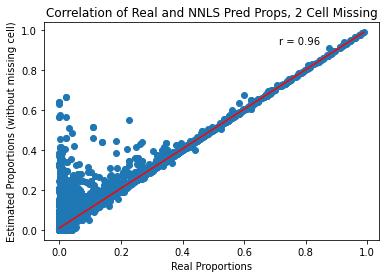

Real Proportions shape: (13000,)
Estimated Proportions shape: (13000,)


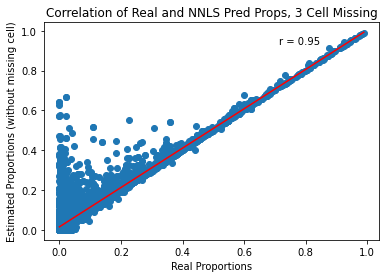

Real Proportions shape: (12000,)
Estimated Proportions shape: (12000,)


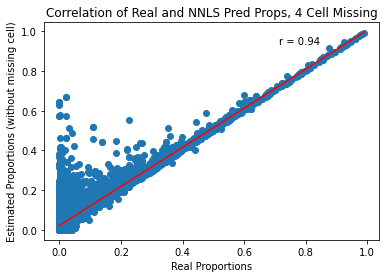

Real Proportions shape: (8000,)
Estimated Proportions shape: (8000,)


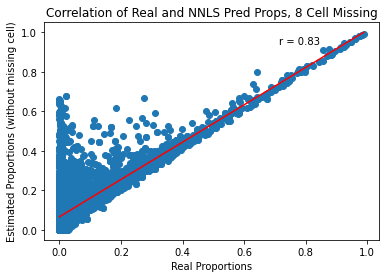

Real Proportions shape: (4000,)
Estimated Proportions shape: (4000,)


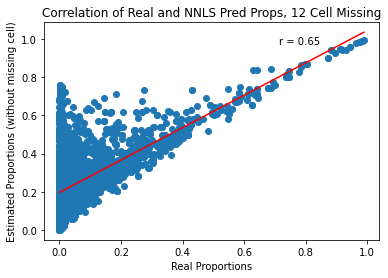

In [ ]:
for num in num_missing_cells:
    
    real_proportions = all_prop_refs[num].values.flatten().astype(float)
    estimated_proportions = calc_prop_tot[num].values.flatten().astype(float)

    # Print the shapes of the matrices
    print("Real Proportions shape:", real_proportions.shape)
    print("Estimated Proportions shape:", estimated_proportions.shape)

    correlation_coefficient = np.corrcoef(real_proportions, estimated_proportions)[0,1]

    # Create a scatter plot
    plt.scatter(real_proportions.flatten(), estimated_proportions.flatten())
    x = real_proportions
    y = estimated_proportions
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
    plt.xlabel('Real Proportions')
    plt.ylabel('Estimated Proportions (without missing cell)')
    plt.title(f'Correlation of Real and NNLS Pred Props, {num} Cell Missing')
    plt.show()

**Singular Value Decomposition**

SVD on each residual matrix, where each line represents a bulk sample.

U: Left singular vectors, representing the column space of the original matrix. (cells)

Σ or sigma: Singular values, representing the diagonal matrix of singular values.

Vh or V^T: Right singular vectors, representing the row space of the original matrix. (sample)

In [ ]:
# SVD on pseudobulk
df = pseudo_df_real.T
Mat_pseudo = df.astype("float32")
U_pseudo, s_pseudo, V_pseudo = sp.linalg.svd(Mat_pseudo)
U_pseudo = pd.DataFrame(U_pseudo)
s_pseudo = pd.DataFrame(s_pseudo)
V_pseudo = pd.DataFrame(V_pseudo)

In [ ]:
# SVD on residual
U_all = dict()
s_all = dict()
V_all = dict()
Matres_all = dict()

for num in num_cells_missing:
    df = residuals[num].T
    Mat = df.astype("float32")
    U, s, V = sp.linalg.svd(Mat)
    U = pd.DataFrame(U)
    s = pd.DataFrame(s)
    V = pd.DataFrame(V)

    U_all[num] = U
    s_all[num] = s
    V_all[num] = V
    Matres_all[num] = Mat

In [ ]:
#SVD on residual with another baseline 
U_all_realgt = dict()
s_all_realgt = dict()
V_all_realgt = dict()
Matres_all_realgt = dict()

for num in num_cells_missing:
    df = residuals_realgt[num].T
    Mat = df.astype("float32")
    U, s, V = sp.linalg.svd(Mat)
    U = pd.DataFrame(U)
    s = pd.DataFrame(s)
    V = pd.DataFrame(V)

    U_all_realgt[num] = U
    s_all_realgt[num] = s
    V_all_realgt[num] = V
    Matres_all_realgt[num] = Mat

In [ ]:
#SVD on references for NNLS
U_all_ref = dict()
s_all_ref = dict()
V_all_ref = dict()
Matref_all_ref = dict()

for num in num_cells_missing:
    df = all_refs[num].T
    Mat_ref  = df.astype("float32")
    U_ref , s_ref , V_ref  = sp.linalg.svd(Mat_ref )
    U_ref = pd.DataFrame(U_ref )
    s_ref  = pd.DataFrame(s_ref )
    V_ref  = pd.DataFrame(V_ref )

    U_all_ref[num] = U_ref 
    s_all_ref[num] = s_ref 
    V_all_ref[num] = V_ref 
    Matref_all_ref[num] = Mat_ref 

S-Value Eval

In [ ]:
#SVD on recreated matrix
U_all_rec = dict()
s_all_rec = dict()
V_all_rec = dict()
Matres_all_rec = dict()

for num in num_cells_missing:
    df = recreated_mat_all[num].T
    Mat_rec = df.astype("float32")
    U_rec , s_rec , V_rec  = sp.linalg.svd(Mat_rec )
    U_rec  = pd.DataFrame(U_rec )
    s_rec  = pd.DataFrame(s_rec )
    V_rec  = pd.DataFrame(V_rec )

    U_all_rec[num] = U_rec 
    s_all_rec[num] = s_rec 
    V_all_rec[num] = V_rec 
    Matres_all_rec[num] = Mat_rec 

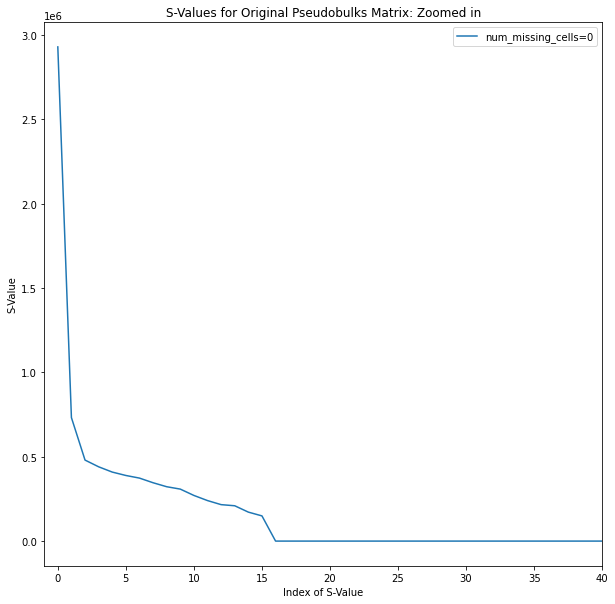

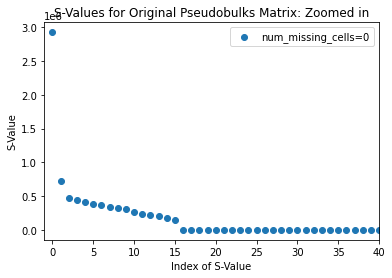

In [ ]:
###SVD on pseudobulk
num =0
plt.figure(figsize = [10,10])
# Create a color map for differentiating the dataframes
color_map = plt.cm.get_cmap('tab10')
# Plotting the scatterplots
dataframe = pd.DataFrame(s_pseudo)
x = dataframe.index
y = dataframe.values.flatten()
color = color_map(num_missing_cells.index(num))
label = f"num_missing_cells={num}"
plt.plot(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Original Pseudobulks Matrix: Zoomed in')
plt.xlim([-1,40])
# Add a legend
plt.legend()
# Display the plot
plt.show()

plt.scatter(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Original Pseudobulks Matrix: Zoomed in')
plt.xlim([-1,40])
# Add a legend
plt.legend()
# Display the plot
plt.show()

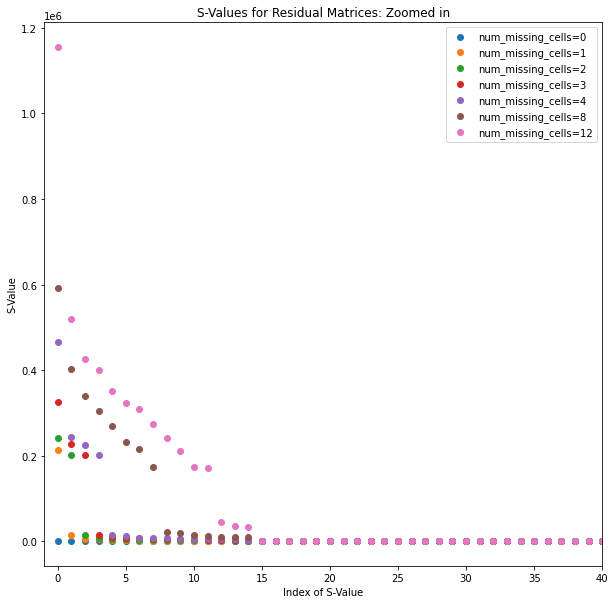

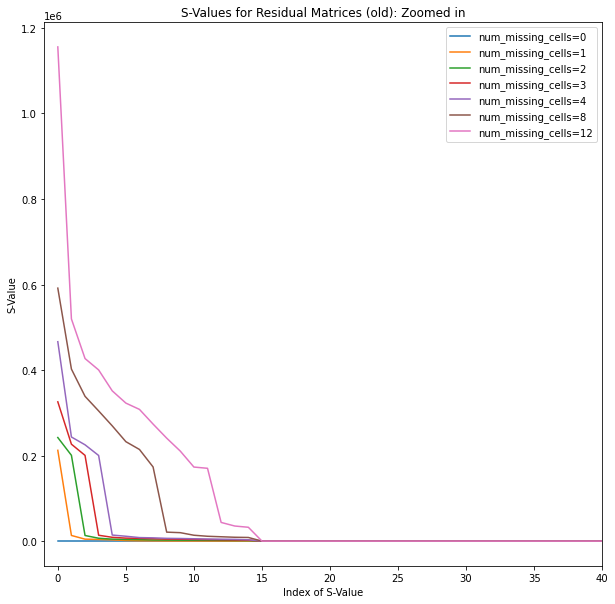

In [ ]:
plt.figure(figsize = [10,10])
# Create a color map for differentiating the dataframes
color_map = plt.cm.get_cmap('tab10')

# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_all[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.scatter(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Residual Matrices: Zoomed in')
plt.xlim([-1,40])
# Add a legend
plt.legend()

# Display the plot
plt.show()
plt.figure(figsize = [10,10])
# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_all[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.plot(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Residual Matrices (old): Zoomed in')
plt.xlim([-1,40])
# Add a legend
plt.legend()
# Display the plot
plt.show()

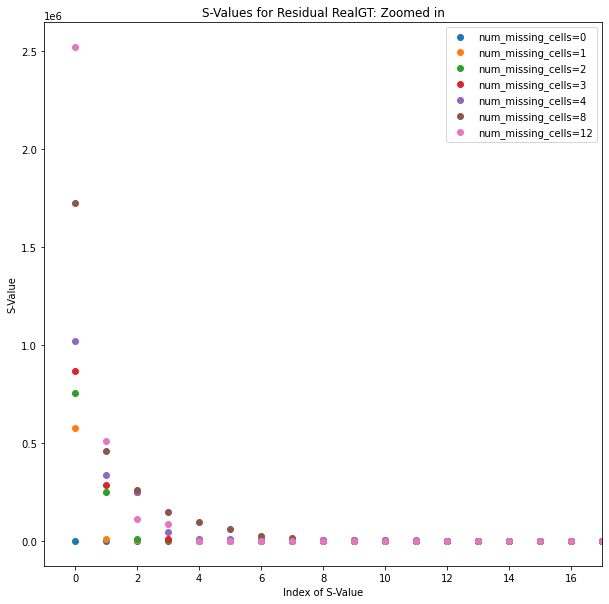

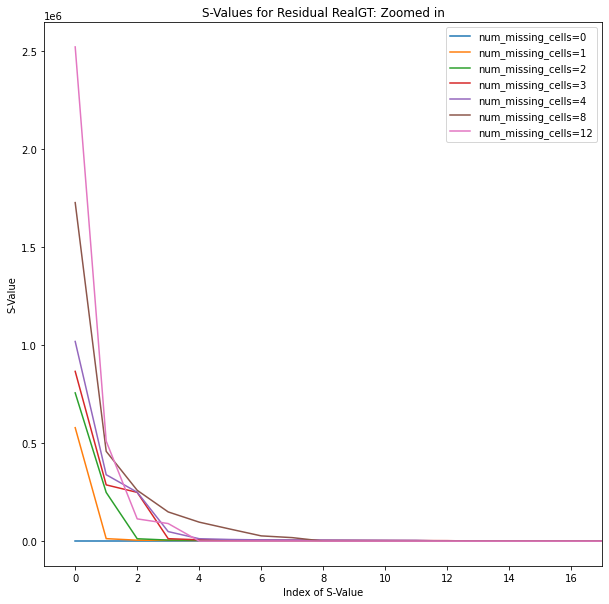

In [ ]:
plt.figure(figsize = [10,10])
# Create a color map for differentiating the dataframes
color_map = plt.cm.get_cmap('tab10')

# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_all_realgt[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.scatter(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Residual RealGT: Zoomed in')
plt.xlim([-1,17])
# Add a legend
plt.legend()

# Display the plot
plt.show()
plt.figure(figsize = [10,10])
# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_all_realgt[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.plot(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Residual RealGT: Zoomed in')
plt.xlim([-1,17])
# Add a legend
plt.legend()
# Display the plot
plt.show()

In [ ]:
# Saving the S-Value index
S_val_elbow = dict()
S_val_elbow[0] = 1
S_val_elbow[1] = 1
S_val_elbow[2] = 2
S_val_elbow[3] = 3
S_val_elbow[4] = 4
S_val_elbow[8] = 8
S_val_elbow[12] = 4

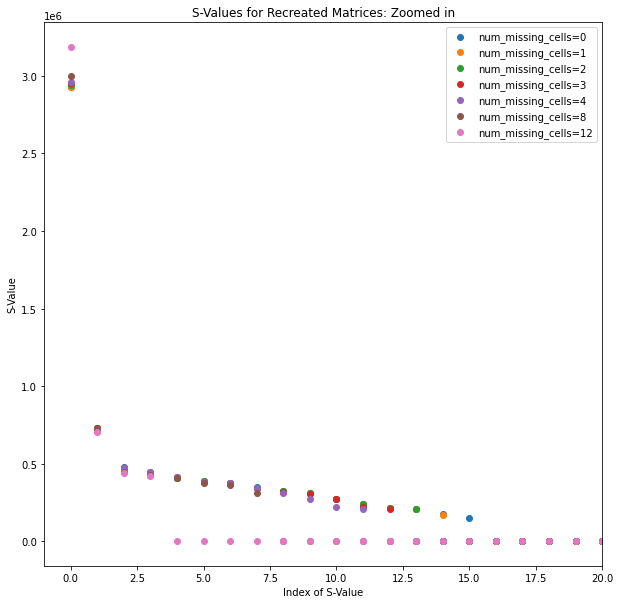

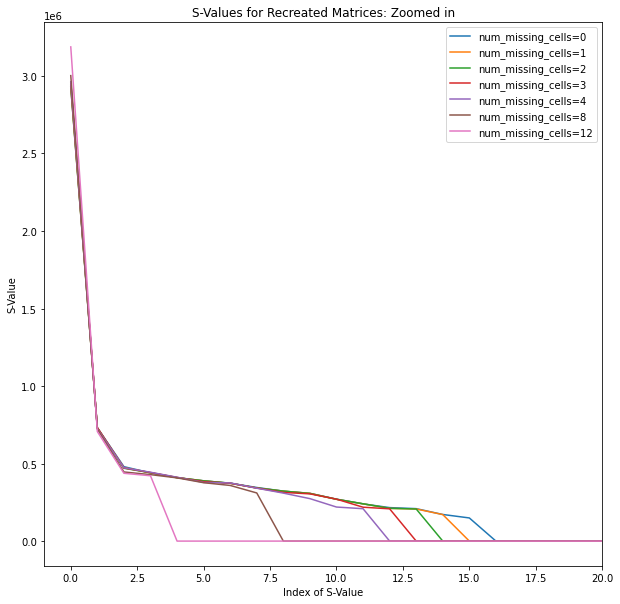

In [ ]:
plt.figure(figsize = [10,10])
# Create a color map for differentiating the dataframes
color_map = plt.cm.get_cmap('tab10')

# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_all_rec[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.scatter(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Recreated Matrices: Zoomed in')
plt.xlim([-1,20])
# Add a legend
plt.legend()

# Display the plot
plt.show()
plt.figure(figsize = [10,10])
# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_all_rec[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.plot(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Recreated Matrices: Zoomed in')
plt.xlim([-1,20])
# Add a legend
plt.legend()
# Display the plot
plt.show()

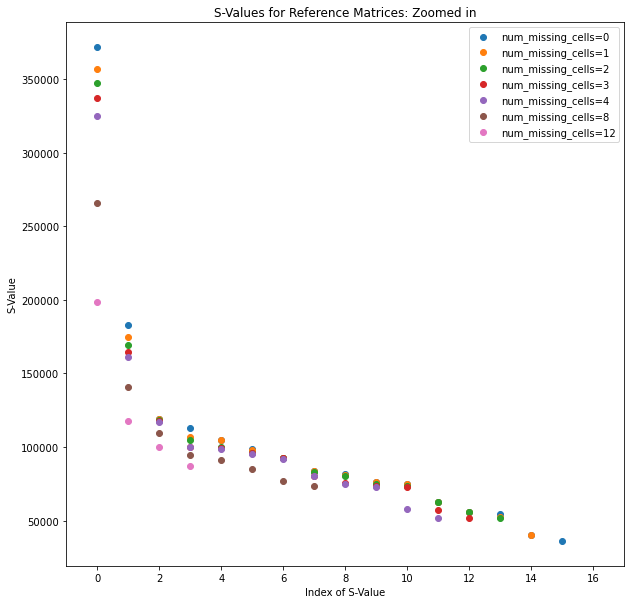

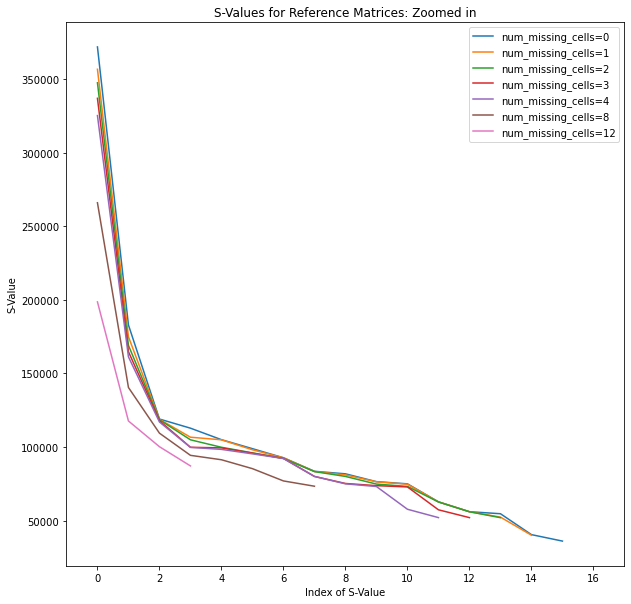

In [ ]:
plt.figure(figsize = [10,10])
# Create a color map for differentiating the dataframes
color_map = plt.cm.get_cmap('tab10')

# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_all_ref[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.scatter(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Reference Matrices: Zoomed in')
plt.xlim([-1,17])
# Add a legend
plt.legend()

# Display the plot
plt.show()
plt.figure(figsize = [10,10])
# Plotting the scatterplots
for num in num_missing_cells:
    dataframe = s_all_ref[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"num_missing_cells={num}"
    plt.plot(x, y, color=color, label=label)

# Set labels and title
plt.xlabel('Index of S-Value')
plt.ylabel('S-Value')
plt.title('S-Values for Reference Matrices: Zoomed in')
plt.xlim([-1,17])
# Add a legend
plt.legend()
# Display the plot
plt.show()

Variance Explained with S:

In [ ]:
s_var_explained = dict()
for num in num_missing_cells:
    var_explained = np.round(s_all[num]**2/np.sum(s_all[num]**2), decimals=3)
    s_var_explained[num] = var_explained

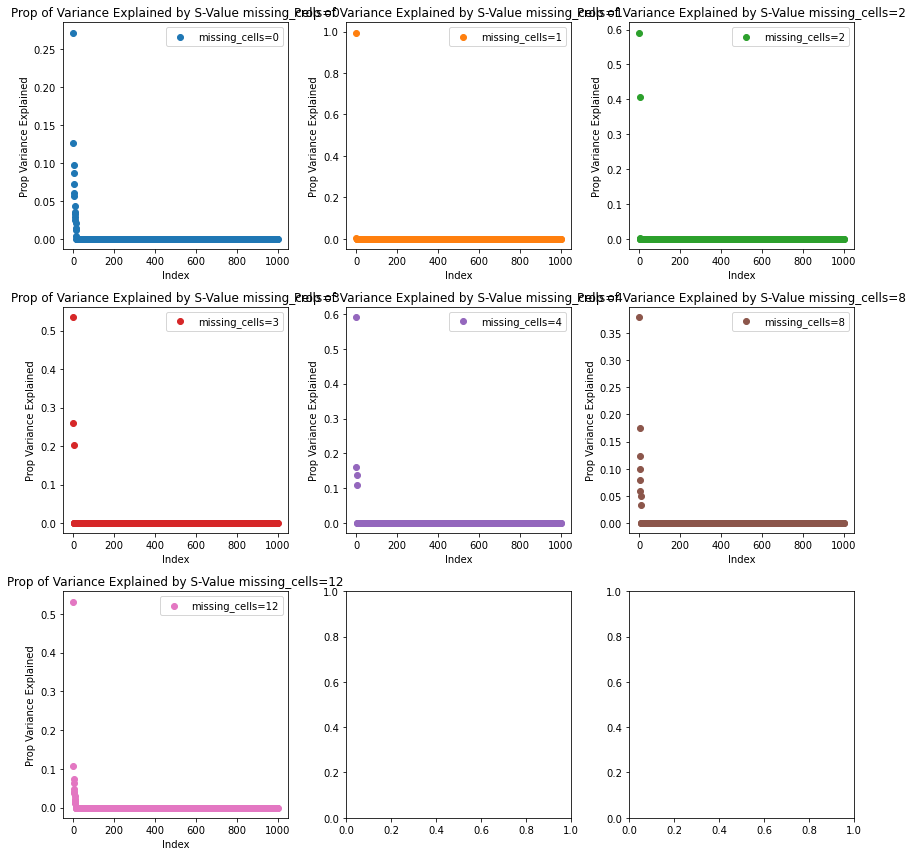

In [ ]:
# Create a color map for differentiating the dataframes
color_map = plt.cm.get_cmap('tab10')

# Create a 3x3 figure with subplots
fig, axs = plt.subplots(3, 3, figsize=(12, 12))

# Plotting the scatterplots
for i, num in enumerate(num_missing_cells):
    dataframe = s_var_explained[num]
    x = dataframe.index
    y = dataframe.values.flatten()
    color = color_map(num_missing_cells.index(num))
    label = f"missing_cells={num}"

    # Determine the subplot indices
    row = i // 3
    col = i % 3

    # Plot on the corresponding subplot
    axs[row, col].scatter(x, y, color=color, label=label)
    axs[row, col].set_xlabel('Index')
    axs[row, col].set_ylabel('Prop Variance Explained')
    axs[row, col].set_title(f"Prop of Variance Explained by S-Value {label}")
    axs[row, col].legend()
# Adjust spacing between subplots
plt.tight_layout()

# Display the plot
plt.show()

Extracting missing cell info:
1. Cell Expression
2. Cell Proportions
3. Multiplyng the missing cell expression, times the missing cell proportions.
4. Individually multiplying cell expression, times missing cell proportions.

In [ ]:
# Get the corresponding missing_cell_tot dataframe
missing_cell_exp = dict()
missing_cell_exp[0] = []
for num in num_cells_missing[1:]:
    missing_cell_exp[num] = all_refs[0][missing_cell_tot[num].columns]  

In [ ]:
# Get the corresponding missing_cell_tot dataframe
missing_cell_prop = dict()
missing_cell_prop[0] = []
for num in num_cells_missing[1:]:
    missing_cell_prop[num] = prop_df[missing_cell_tot[num].columns]  

In [ ]:
missing_cell_exp_x_prop = dict()
missing_cell_exp_x_prop[0] = []
for num in num_missing_cells[1:]:
    # Assuming missing_cell_exp and missing_cell_prop are dictionaries
    missing_cell_exp_matrix = missing_cell_exp[num]  # shape: (28518, num)
    missing_cell_prop_matrix = missing_cell_prop[num]  # shape: (1000, num)

    # Perform matrix multiplication
    result_matrix = np.dot(missing_cell_exp_matrix, missing_cell_prop_matrix.T)  # shape: (28518, 1000)

    print(f"Result matrix shape for num={num}: {result_matrix.shape}")
    #convert to dataframe
    missing_cell_exp_x_prop[num] = pd.DataFrame(result_matrix.T, columns = gene_ids)
missing_cell_exp_x_prop[1]    

Result matrix shape for num=1: (4318, 1000)
Result matrix shape for num=2: (4318, 1000)
Result matrix shape for num=3: (4318, 1000)
Result matrix shape for num=4: (4318, 1000)
Result matrix shape for num=8: (4318, 1000)
Result matrix shape for num=12: (4318, 1000)


,A2M,A2M-AS1,A2ML1,AADACL2-AS1,AADACL4,AATK,ABCA10,ABCA4,ABCA6,ABCA8,...,ZSCAN1,ZSCAN31,ZSWIM4,ZSWIM5,C2CD4B,CCL4L2,CXCL8,IGHA1,AC139722.1,AQP4
0,158.814826,3.201577,2.549344,9.327748,0.0,4.640071,30.765618,0.0,223.092766,42.31661,...,0.0,6.212976,18.371391,14.894523,0.553133,4.323049,8.197581,0.153549,0.0,1.192648
1,1034.209802,20.848821,16.601454,60.742745,0.0,30.216365,200.347185,0.0,1452.790842,275.567802,...,0.0,40.459196,119.635386,96.993853,3.60203,28.151902,53.383041,0.999921,0.0,7.766579
2,1458.991626,29.412074,23.420182,85.691662,0.0,42.627157,282.635946,0.0,2049.496794,388.751987,...,0.0,57.077034,168.773325,136.832217,5.081494,39.714755,75.309101,1.41062,0.0,10.956552
3,103.325309,2.082953,1.65861,6.068655,0.0,3.018841,20.016185,0.0,145.144691,27.531288,...,0.0,4.042177,11.952472,9.690413,0.35987,2.812586,5.333366,0.0999,0.0,0.775939
4,142.550657,2.873704,2.288267,8.372497,0.0,4.164883,27.614922,0.0,200.245916,37.982981,...,0.0,5.576707,16.489984,13.369181,0.496487,3.880327,7.35807,0.137825,0.0,1.070509
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
996,552.981744,11.147658,8.876633,32.478545,0.0,16.156391,107.123657,0.0,776.792883,147.343376,...,0.0,21.633132,63.967857,51.861653,1.92597,15.052543,28.543384,0.534648,0.0,4.152713
997,11.48059,0.231439,0.18429,0.674295,0.0,0.335427,2.224021,0.0,16.127188,3.059032,...,0.0,0.449131,1.328052,1.076713,0.039986,0.31251,0.592596,0.0111,0.0,0.086215
998,3.826863,0.077146,0.06143,0.224765,0.0,0.111809,0.74134,0.0,5.375729,1.019677,...,0.0,0.14971,0.442684,0.358904,0.013329,0.10417,0.197532,0.0037,0.0,0.028738


In [ ]:
ex_prop_individual = dict()
ex_prop_individual[0] = []
for num in num_missing_cells[1:]:
    ex_prop_individual[num] = dict()
    x = missing_cell_exp[num].T
    y = missing_cell_prop[num]
    for col_cell, row in x.iterrows():
        exp = row.values
        prop = y[col_cell].values
        # Perform matrix multiplication
        result_matrix = np.dot(missing_cell_exp_matrix, missing_cell_prop_matrix.T)  
        #convert to dataframe  
        ex_prop_individual[num][col_cell] = pd.DataFrame(result_matrix.T, columns = gene_ids) 

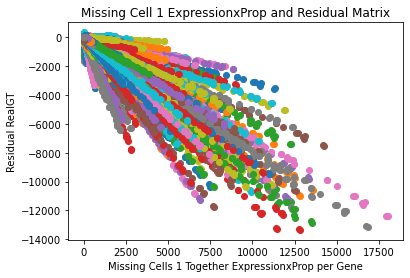

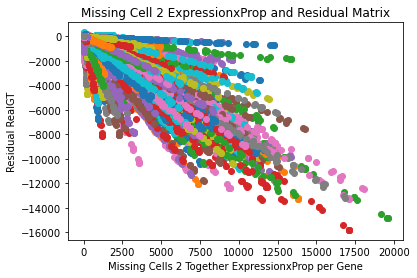

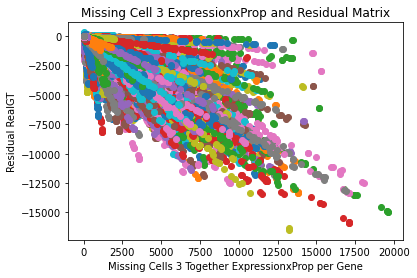

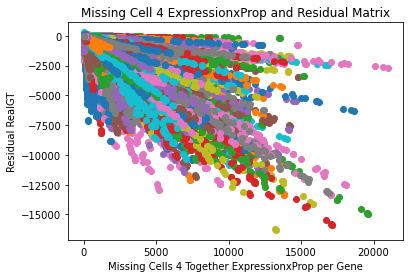

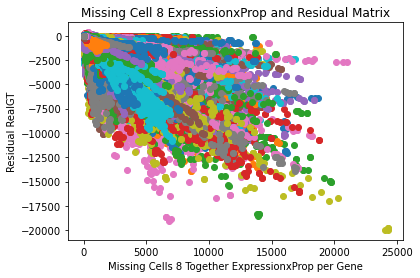

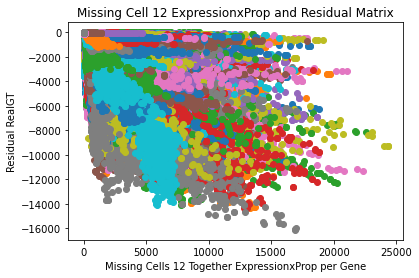

In [250]:
for num in num_missing_cells[1:]:
    for gene in residuals_realgt[num].columns:
        y = residuals_realgt[num][gene]
        x = missing_cell_exp_x_prop[num][gene]
        plt.scatter(x,y)
    plt.title(f"Missing Cell {num} ExpressionxProp and Residual Matrix")
    plt.xlabel(f"Missing Cells {num} Together ExpressionxProp per Gene")
    plt.ylabel(f"Residual RealGT")
    plt.show()    

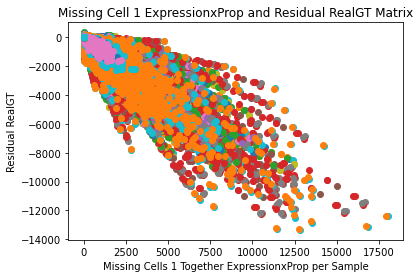

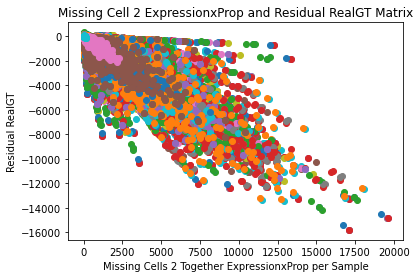

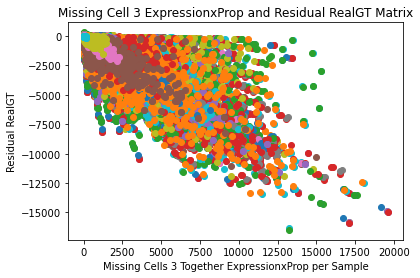

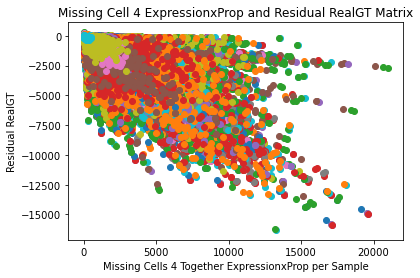

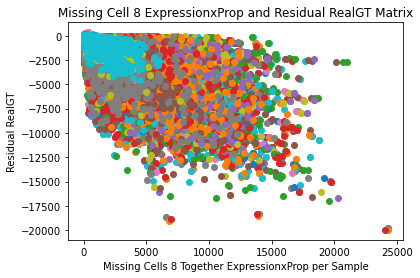

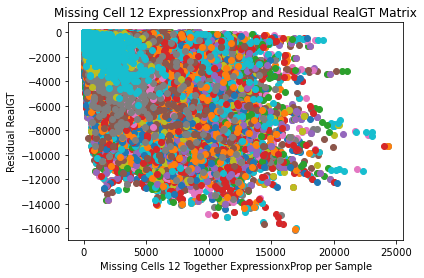

In [251]:
for num in num_missing_cells[1:]:
    for row in range(0, len(residuals_realgt[num])):
        y = residuals_realgt[num].iloc[row]
        x = missing_cell_exp_x_prop[num].iloc[row]
        plt.scatter(x,y)
    plt.title(f"Missing Cell {num} ExpressionxProp and Residual RealGT Matrix")
    plt.xlabel(f"Missing Cells {num} Together ExpressionxProp per Sample")
    plt.ylabel(f"Residual RealGT")
    plt.show()    

In [252]:
# for num in num_missing_cells[1:]:
#     for gene in residuals[num].columns:
#         y = residuals[num][gene]
#         x = missing_cell_exp_x_prop[num][gene]
#         plt.scatter(x,y)
#     plt.title(f"Missing Cell {num} ExpressionxProp and Residual Matrix")
#     plt.xlabel(f"Missing Cells {num} Together ExpressionxProp per Gene")
#     plt.ylabel(f"Residual (old)")
#     plt.show()    

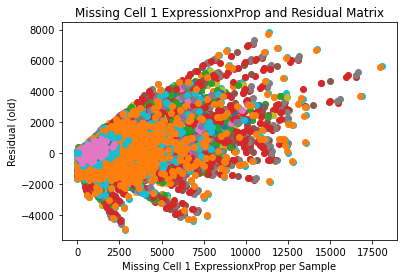

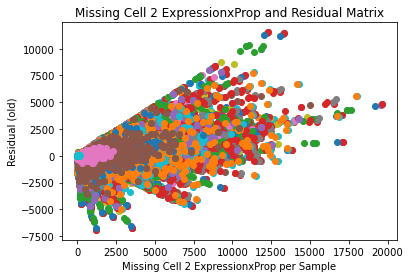

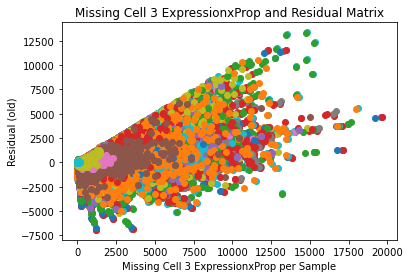

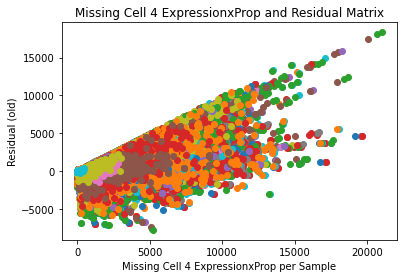

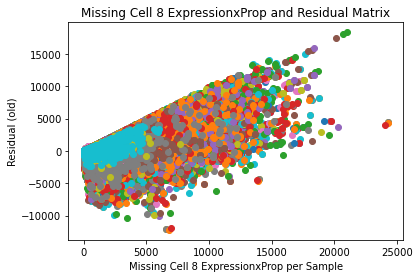

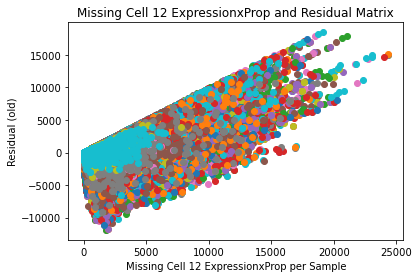

In [253]:
for num in num_missing_cells[1:]:
    for row in range(0, len(residuals[num])):
        y = residuals[num].iloc[row]
        x = missing_cell_exp_x_prop[num].iloc[row]
        plt.scatter(x,y)
    plt.title(f"Missing Cell {num} ExpressionxProp and Residual Matrix")
    plt.xlabel(f"Missing Cell {num} ExpressionxProp per Sample")
    plt.ylabel(f"Residual (old)")
    plt.show()    

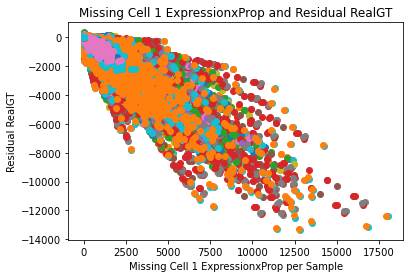

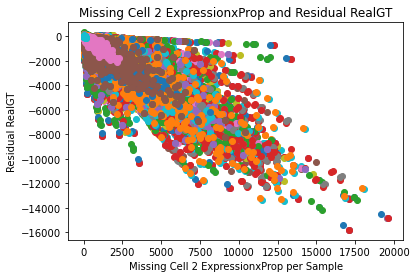

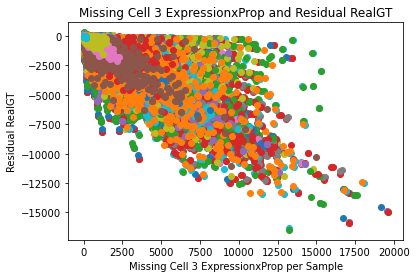

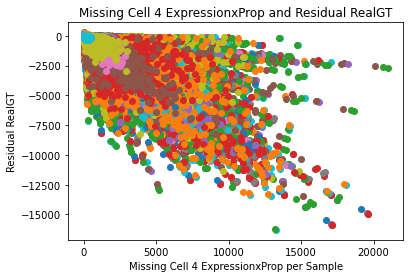

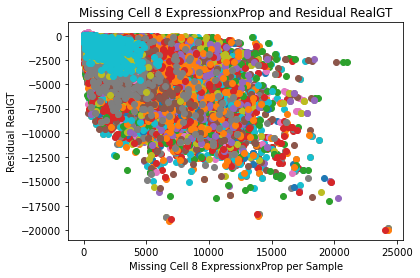

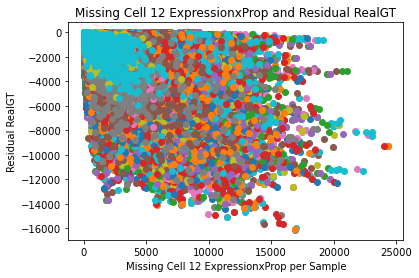

In [254]:
for num in num_missing_cells[1:]:
    for row in range(0, len(residuals_realgt[num])):
        y = residuals_realgt[num].iloc[row]
        x = missing_cell_exp_x_prop[num].iloc[row]
        plt.scatter(x,y)
    plt.title(f"Missing Cell {num} ExpressionxProp and Residual RealGT")
    plt.xlabel(f"Missing Cell {num} ExpressionxProp per Sample")
    plt.ylabel(f"Residual RealGT")
    plt.show()    

1
dendritic cell


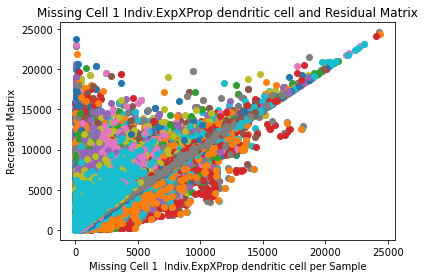

2
dendritic cell


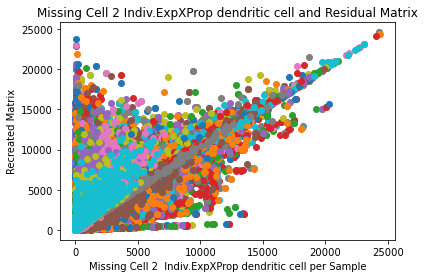

T cell


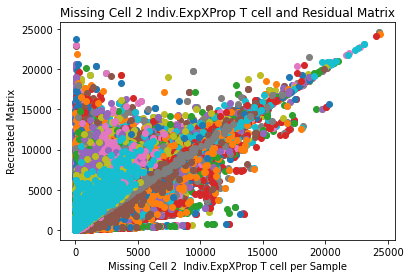

3
dendritic cell


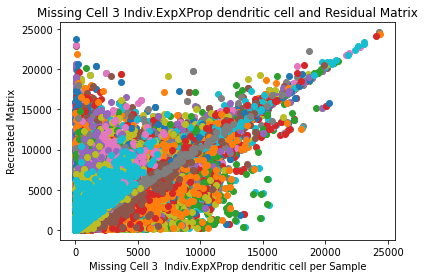

T cell


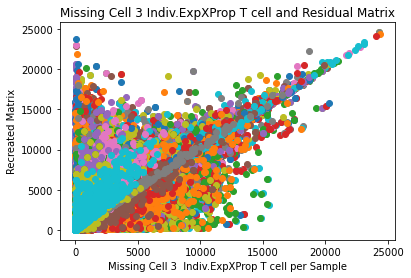

stromal cell of endometrium


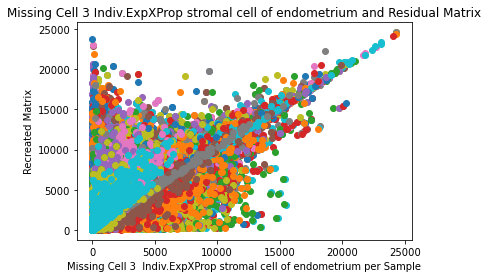

4
dendritic cell


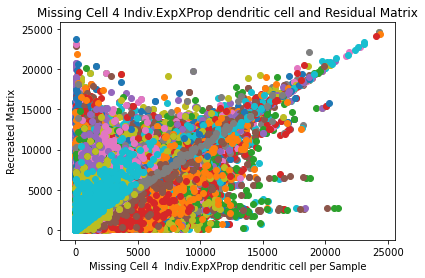

T cell


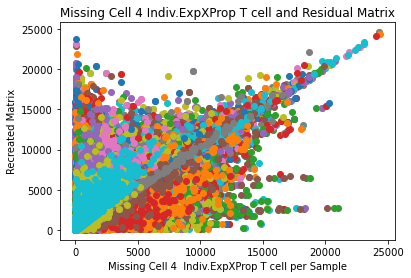

stromal cell of endometrium


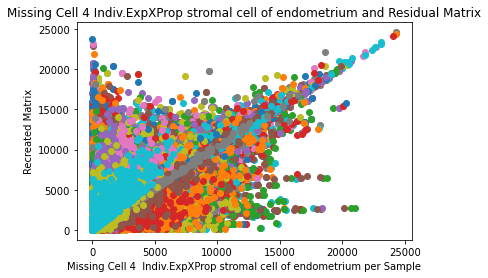

preadipocyte


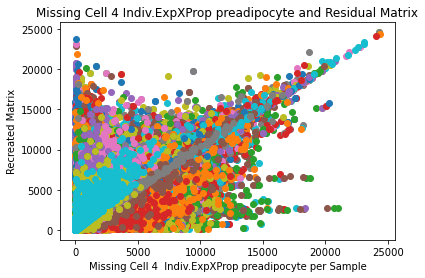

8
dendritic cell


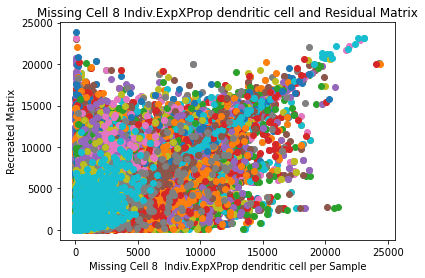

T cell


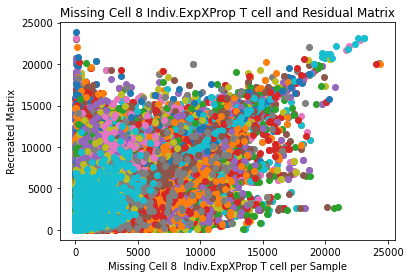

stromal cell of endometrium


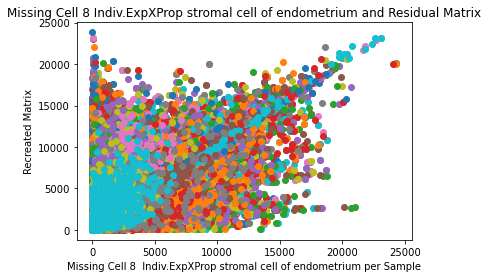

preadipocyte


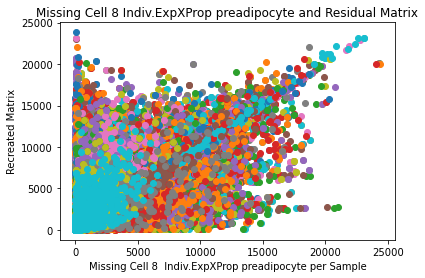

macrophage


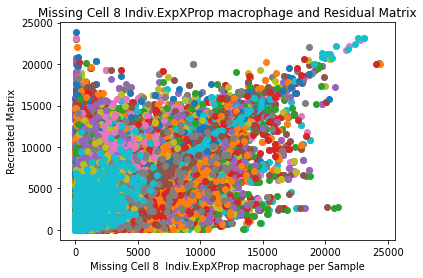

endothelial cell


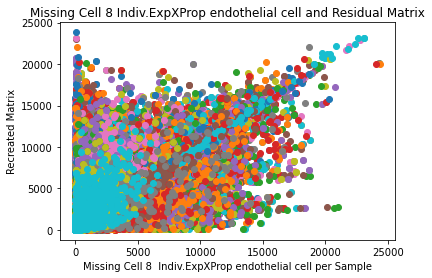

smooth muscle cell


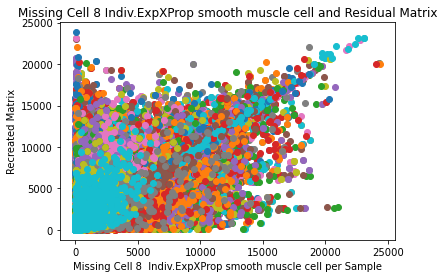

neutrophil


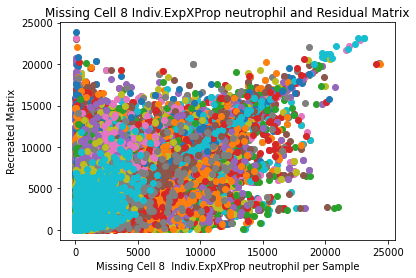

12
dendritic cell


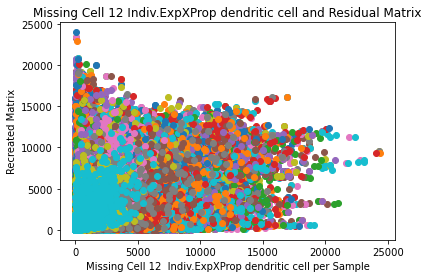

T cell


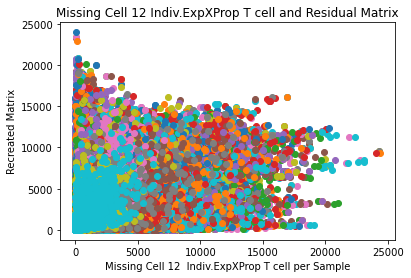

stromal cell of endometrium


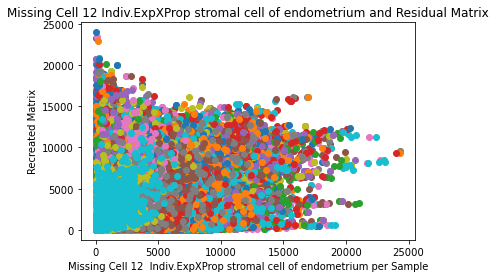

preadipocyte


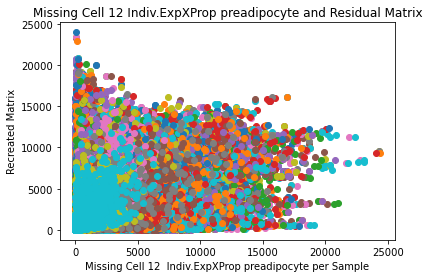

macrophage


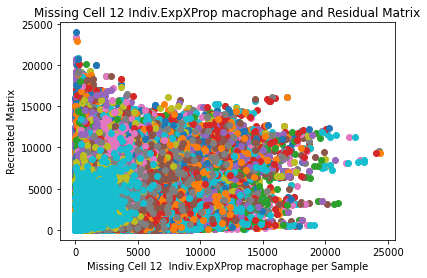

endothelial cell


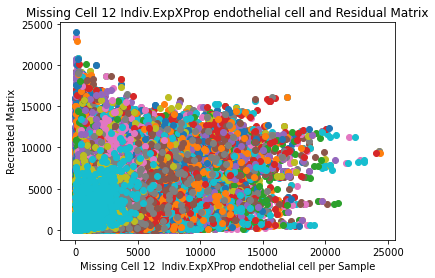

smooth muscle cell


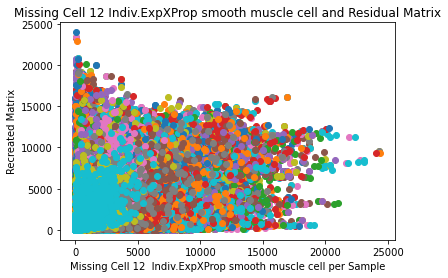

neutrophil


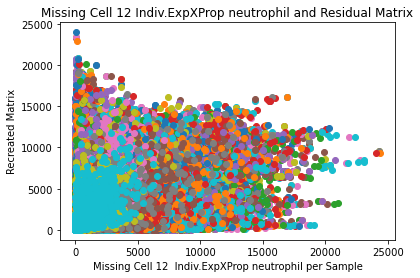

pericyte cell


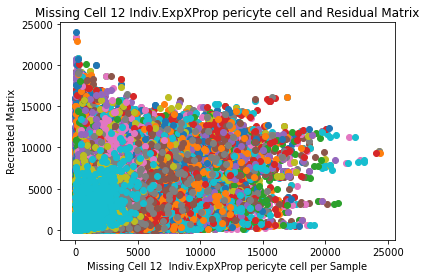

B cell


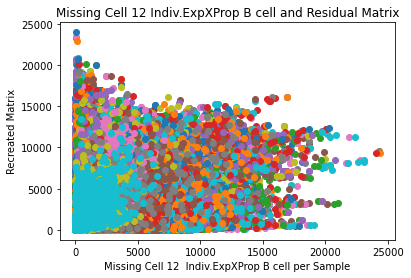

immature NK T cell


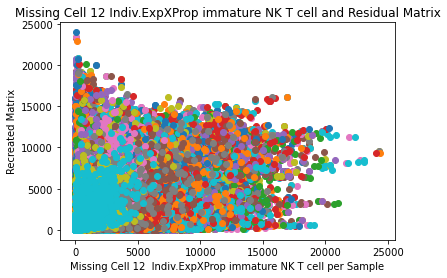

endothelial cell of lymphatic vessel


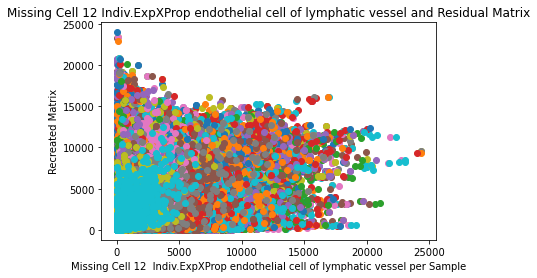

In [255]:
for num in num_missing_cells[1:]:
    print(num)
    dicti = ex_prop_individual[num]
    for cell in dicti:
        print(cell)
        x = dicti[cell]
        for index, cells in x.iterrows():
            x = cells.values
            y = recreated_mat_all[num].iloc[index].values
            plt.scatter(x,y)
        plt.title(f"Missing Cell {num} Indiv.ExpXProp {cell} and Residual Matrix")
        plt.xlabel(f"Missing Cell {num}  Indiv.ExpXProp {cell} per Sample")
        plt.ylabel(f"Recreated Matrix")
        plt.show()    

1
dendritic cell


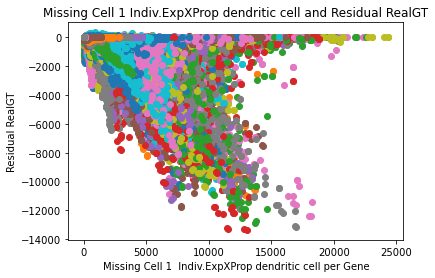

2
dendritic cell
T cell


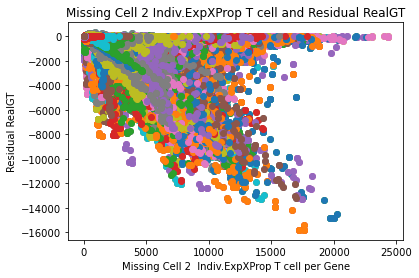

3
dendritic cell
T cell
stromal cell of endometrium


In [256]:
for num in num_missing_cells[1:5]:
    print(num)
    dicti = ex_prop_individual[num]
    for cell in dicti:
        print(cell)
        x = dicti[cell]
        for gene in x.columns:
            real_gene_exp = x[gene].values
            y = residuals_realgt[num][gene].values
            plt.scatter(real_gene_exp ,y)
        plt.title(f"Missing Cell {num} Indiv.ExpXProp {cell} and Residual RealGT")
        plt.xlabel(f"Missing Cell {num}  Indiv.ExpXProp {cell} per Gene")
        plt.ylabel(f"Residual RealGT")
    plt.show()    


**Reconstructing Residual Matrix**

With highly variable genes that match elbow S:

In [ ]:
#reconstructing Matrix with 30 S matching elbow plot, without V.
Recon_Mat_matchS = dict()
num_SVs = 30 
for num in num_cells_missing:
    #cutting S and U to 30 to match elbow plots
    U = U_all[num].values[:, :num_SVs]
    S = np.zeros((U.shape[1], Matres_all[num].shape[0]))
    diag_val = s_all[num].values[:num_SVs]
    np.fill_diagonal(S, [diag_val])

    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_matchS[num] = pd.DataFrame(anum)
#QC    
Recon_Mat_matchS[0]    

,0,1,2,3,4,5,6,7,8,9,...,4308,4309,4310,4311,4312,4313,4314,4315,4316,4317
0,-3.605972e-11,-1.050233e-10,8.707971e-12,1.130136e-10,-5.067386e-11,-1.971227e-12,1.298476e-11,1.283840e-11,1.993234e-11,-7.359058e-12,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1.250278e-12,7.590655e-13,-3.709731e-12,1.649709e-11,-1.824000e-11,-8.619012e-13,7.068995e-12,-2.457112e-12,-4.112195e-12,3.915843e-12,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,-6.408136e-14,-7.230260e-13,-9.060318e-13,-5.289521e-13,1.021440e-12,8.443978e-14,5.881404e-13,-2.137281e-13,4.597259e-13,-3.457663e-14,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,-6.032275e-13,-6.155986e-12,1.109897e-12,-4.938324e-12,-2.815058e-12,-4.916948e-12,-1.806280e-12,-4.845406e-13,2.896686e-12,1.181430e-12,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,-3.340371e-13,3.149872e-13,-3.732951e-13,-4.286081e-13,-2.171455e-13,-3.232609e-13,2.622031e-13,-5.002799e-13,4.687583e-13,-1.678699e-13,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4313,2.335044e-12,4.880552e-13,-6.294498e-13,2.647673e-12,-2.029621e-12,-1.177008e-12,-5.710153e-13,2.741550e-13,9.593959e-13,2.281806e-12,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4314,1.224587e-12,-2.030591e-12,2.824790e-13,-1.246437e-13,-6.741280e-13,-1.735803e-13,-4.946707e-13,8.526355e-14,1.845139e-13,5.407924e-15,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4315,1.087172e-12,6.590159e-12,-6.208143e-13,-8.175507e-13,6.313724e-13,2.238425e-13,-6.765927e-12,-3.280016e-12,-3.055892e-12,-9.589927e-12,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4316,-2.785131e-13,-5.547696e-13,-1.054440e-12,1.064438e-12,-2.591660e-12,1.617810e-13,2.083426e-12,-1.216194e-12,-1.601567e-12,-4.980105e-13,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
#reconstructing Matrix with 30 S matching elbow plot, without V.
Recon_Mat_matchS_realGT = dict()

for num in num_cells_missing:
    num_SV = S_val_elbow[num]
    #cutting S and U to 30 to match elbow plots
    U = U_all_realgt[num].values[:, :num_SV]
    S = np.zeros((U.shape[1], Matres_all_realgt[num].shape[0]))
    diag_val = s_all_realgt[num].values[:num_SV]
    np.fill_diagonal(S, [diag_val])

    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_matchS_realGT[num] = pd.DataFrame(anum[:, 0:num_SV])
#QC    
Recon_Mat_matchS_realGT[0]    

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
0,-3.605972e-11,-1.050233e-10,8.707971e-12,1.130136e-10,-5.067386e-11,-1.971227e-12,1.298476e-11,1.283840e-11,1.993234e-11,-7.359058e-12,-4.477989e-12,5.649737e-12,7.161199e-12,5.535724e-12,4.410346e-13
1,1.250278e-12,7.590655e-13,-3.709731e-12,1.649709e-11,-1.824000e-11,-8.619012e-13,7.068995e-12,-2.457112e-12,-4.112195e-12,3.915843e-12,2.473605e-12,3.364505e-12,-1.530490e-13,1.851663e-12,2.215690e-12
2,-6.408136e-14,-7.230260e-13,-9.060318e-13,-5.289521e-13,1.021440e-12,8.443978e-14,5.881404e-13,-2.137281e-13,4.597259e-13,-3.457663e-14,5.919680e-13,5.012848e-13,-1.862703e-13,-9.184028e-14,-1.680738e-14
3,-6.032275e-13,-6.155986e-12,1.109897e-12,-4.938324e-12,-2.815058e-12,-4.916948e-12,-1.806280e-12,-4.845406e-13,2.896686e-12,1.181430e-12,1.844461e-12,-4.423638e-12,-1.815890e-12,-7.999748e-13,2.712572e-13
4,-3.340371e-13,3.149872e-13,-3.732951e-13,-4.286081e-13,-2.171455e-13,-3.232609e-13,2.622031e-13,-5.002799e-13,4.687583e-13,-1.678699e-13,-2.125687e-15,1.326958e-14,-8.428295e-13,1.884786e-13,-3.198078e-15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4313,2.335044e-12,4.880552e-13,-6.294498e-13,2.647673e-12,-2.029621e-12,-1.177008e-12,-5.710153e-13,2.741550e-13,9.593959e-13,2.281806e-12,7.249283e-13,4.475911e-13,-4.480337e-13,-2.039102e-12,-1.314069e-12
4314,1.224587e-12,-2.030591e-12,2.824790e-13,-1.246437e-13,-6.741280e-13,-1.735803e-13,-4.946707e-13,8.526355e-14,1.845139e-13,5.407924e-15,-4.223175e-14,3.400268e-13,1.641886e-13,7.888631e-13,-1.276907e-12
4315,1.087172e-12,6.590159e-12,-6.208143e-13,-8.175507e-13,6.313724e-13,2.238425e-13,-6.765927e-12,-3.280016e-12,-3.055892e-12,-9.589927e-12,2.472559e-12,-1.510517e-12,3.473094e-13,-2.330265e-12,1.316286e-12
4316,-2.785131e-13,-5.547696e-13,-1.054440e-12,1.064438e-12,-2.591660e-12,1.617810e-13,2.083426e-12,-1.216194e-12,-1.601567e-12,-4.980105e-13,2.311990e-13,1.263281e-13,-1.017471e-12,-2.443159e-14,1.359859e-13


In [ ]:
#reconstructing Matrix with 30 S matching elbow plot, without V.
Recon_Mat_oneS_realGT = dict()
num_SV = 1
for num in num_cells_missing:
    num_SV = 1
    #cutting S and U to 30 to match elbow plots
    U = U_all_realgt[num].values[:, :num_SV]
    S = np.zeros((U.shape[1], Matres_all_realgt[num].shape[0]))
    diag_val = s_all_realgt[num].values[:num_SV]
    np.fill_diagonal(S, [diag_val])

    anum = U @ S #reconstructing
    #saving to df dict
    Recon_Mat_oneS_realGT[num] = pd.DataFrame(anum[:, 0:num_SV])
#QC    
Recon_Mat_oneS_realGT[0]    

,0
0,-3.605972e-11
1,1.250278e-12
2,-6.408136e-14
3,-6.032275e-13
4,-3.340371e-13
...,...
4313,2.335044e-12
4314,1.224587e-12
4315,1.087172e-12
4316,-2.785131e-13


Plotting Correlations:

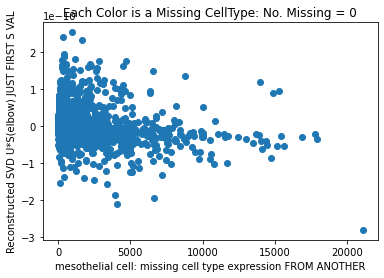

In [ ]:
####QC plot, using mismatched S values######
num = 0
for col in missing_cell_exp[1].columns:
    x = missing_cell_exp[1][col]
    y = Recon_Mat_matchS_realGT[num][0]
    plt.scatter(x,y)
    plt.title(f'Each Color is a Missing CellType: No. Missing = {num}')
    plt.xlabel(f'{col}: missing cell type expression FROM ANOTHER')
    plt.ylabel(f"Reconstructed SVD U*S(elbow) JUST FIRST S VAL")
plt.show()

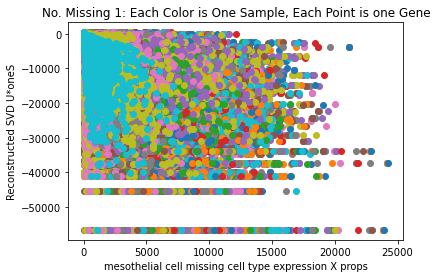

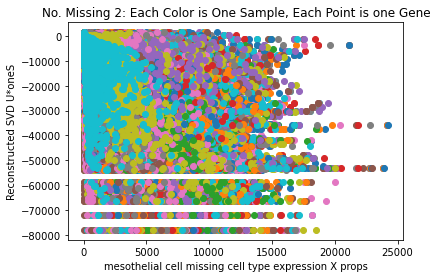

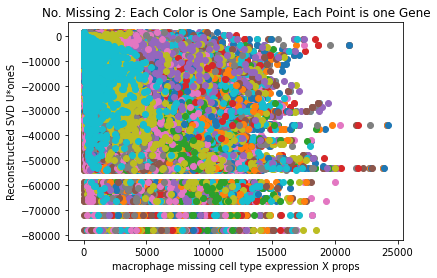

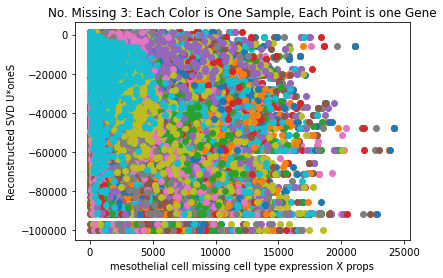

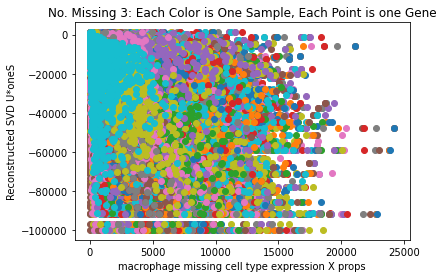

...

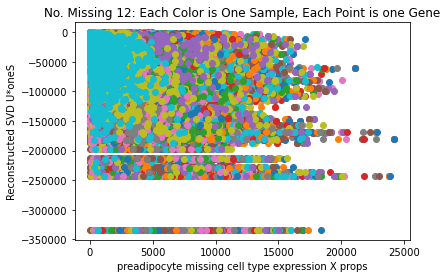

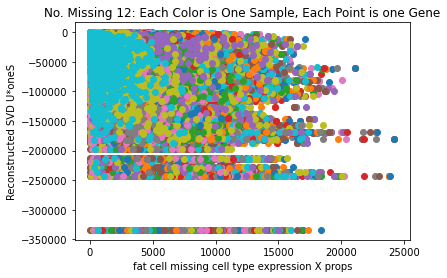

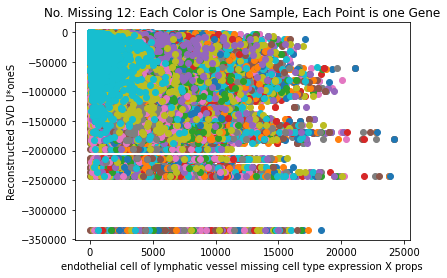

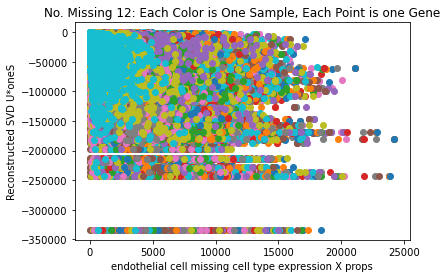

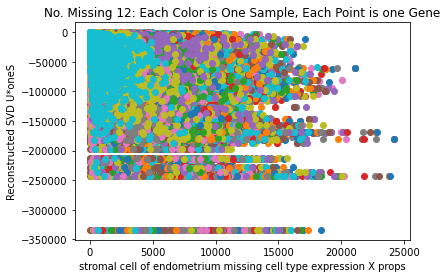

In [ ]:
for num in num_missing_cells[1:]:
    for cell in ex_prop_individual[num]:
        x_all = ex_prop_individual[num][cell]
        for index, row in x_all.iterrows():
            x = row.values
            y = Recon_Mat_oneS_realGT[num][0].values
            plt.scatter(x,y)
        plt.title(f'No. Missing {num}: Each Color is One Sample, Each Point is one Gene')
        plt.xlabel(f'{cell} missing cell type expression X props')
        plt.ylabel(f"Reconstructed SVD U*oneS")
        # plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        # r, p = stats.pearsonr(x, y)
        # plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()

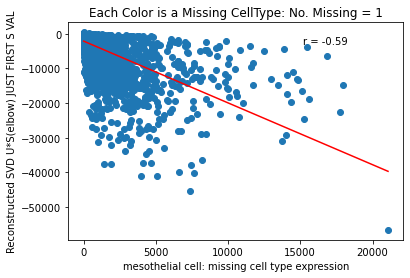

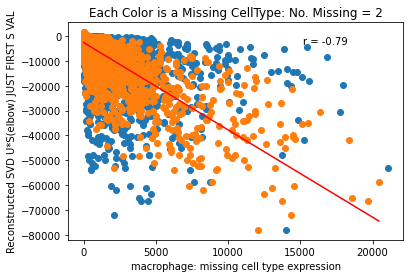

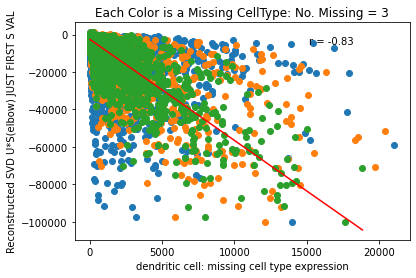

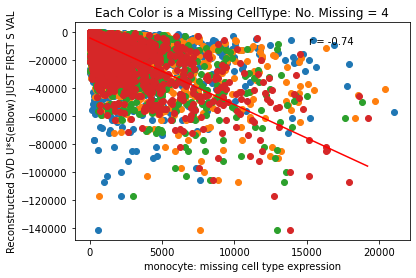

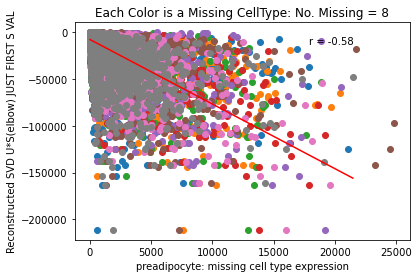

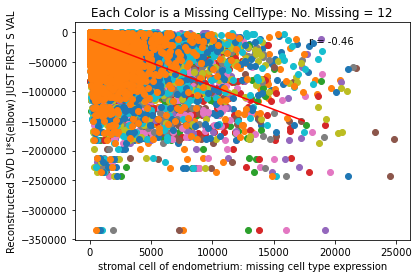

In [ ]:
for num in num_missing_cells[1:]:
    for col in missing_cell_exp[num].columns:
        x = missing_cell_exp[num][col]
        y = Recon_Mat_matchS_realGT[num][0]
        plt.scatter(x,y)

        plt.title(f'Each Color is a Missing CellType: No. Missing = {num}')
        plt.xlabel(f'{col}: missing cell type expression')
        plt.ylabel(f"Reconstructed SVD U*S(elbow) JUST FIRST S VAL")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

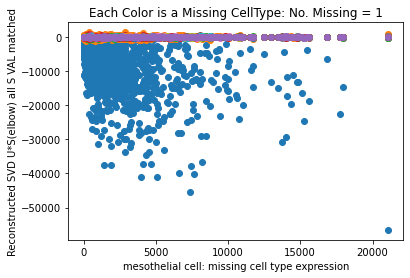

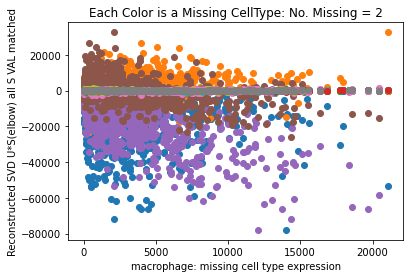

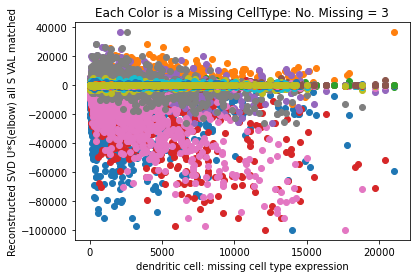

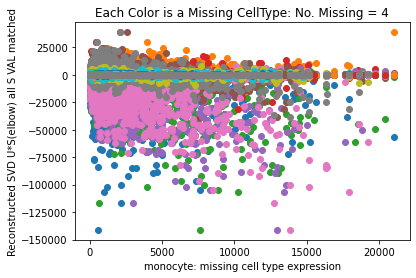

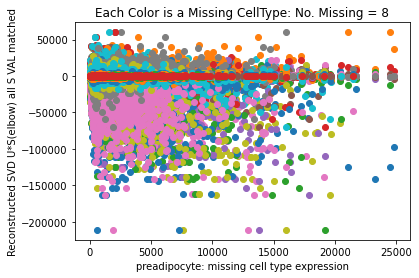

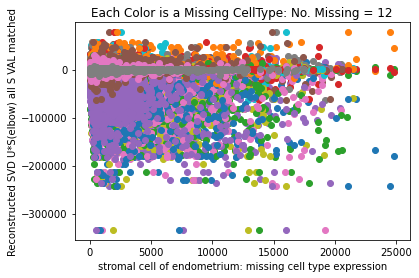

In [ ]:
for num in num_missing_cells[1:]:
    for col in missing_cell_exp[num].columns:
        x = missing_cell_exp[num][col]
        for column in Recon_Mat_matchS_realGT[num].columns:
            y = Recon_Mat_matchS_realGT[num][column]
            plt.scatter(x,y)
        plt.title(f'Each Color is a Missing CellType: No. Missing = {num}')
        plt.xlabel(f'{col}: missing cell type expression')
        plt.ylabel(f"Reconstructed SVD U*S(elbow) all S VAL matched")
    plt.show()

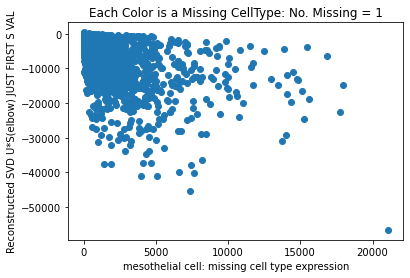

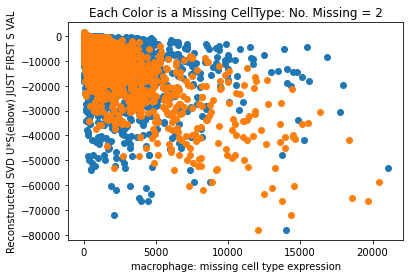

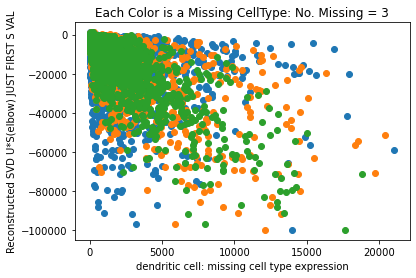

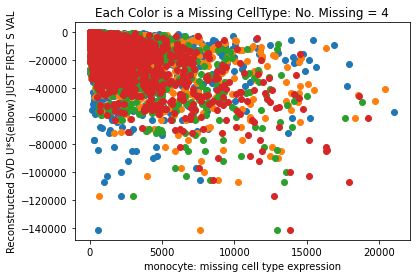

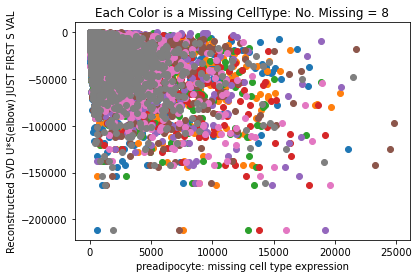

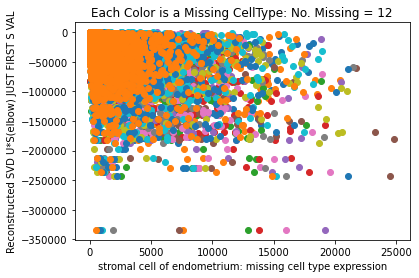

In [ ]:
for num in num_missing_cells[1:]:
    for col in missing_cell_exp[num].columns:
        x = missing_cell_exp[num][col]
        y = Recon_Mat_matchS_realGT[num][0]
        plt.scatter(x,y)
        plt.title(f'Each Color is a Missing CellType: No. Missing = {num}')
        plt.xlabel(f'{col}: missing cell type expression')
        plt.ylabel(f"Reconstructed SVD U*S(elbow) JUST FIRST S VAL")
    plt.show()

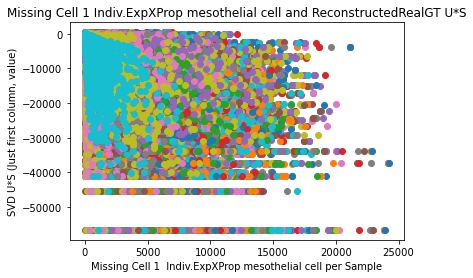

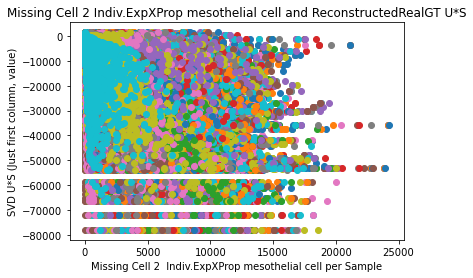

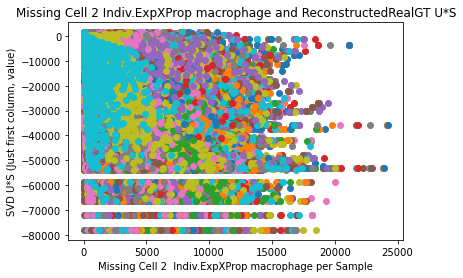

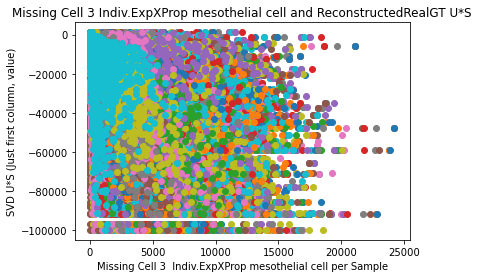

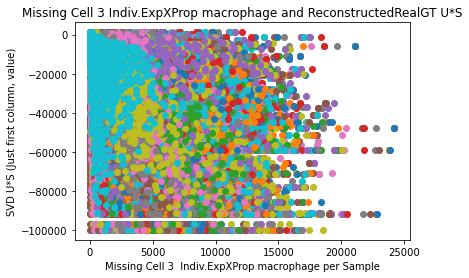

...

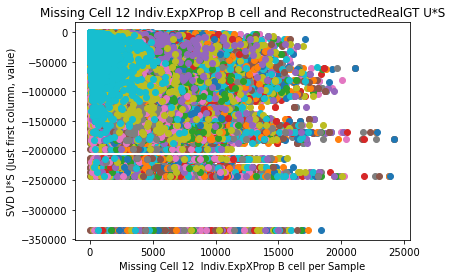

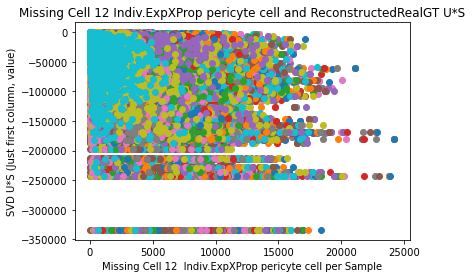

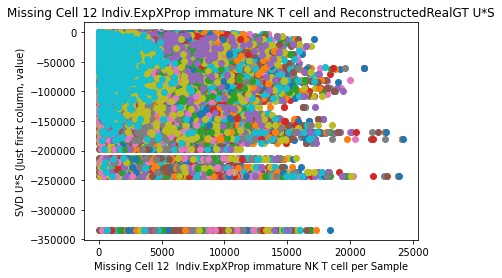

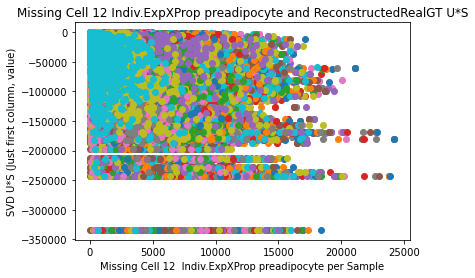

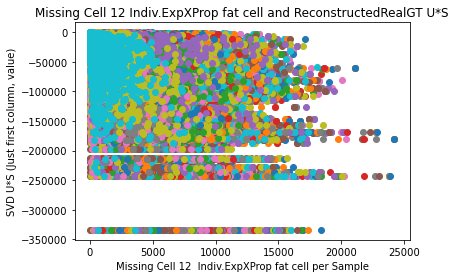

KeyboardInterrupt: 

In [ ]:
for num in num_missing_cells[1:]:
    x_tot = ex_prop_individual[num]
    for cell in x_tot:
        x_all = x_tot[cell]
        for index, cells in x_all.iterrows():
            x = cells.values
            y = Recon_Mat_matchS_realGT[num][0].values
            plt.scatter(x,y)
            plt.title(f"Missing Cell {num} Indiv.ExpXProp {cell} and ReconstructedRealGT U*S")
            plt.xlabel(f"Missing Cell {num}  Indiv.ExpXProp {cell} per Sample")
            plt.ylabel(f"SVD U*S (Just first column, value)")
        # plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        # r, p = stats.pearsonr(x, y)
        # plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()        

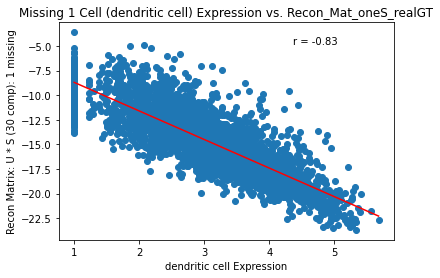

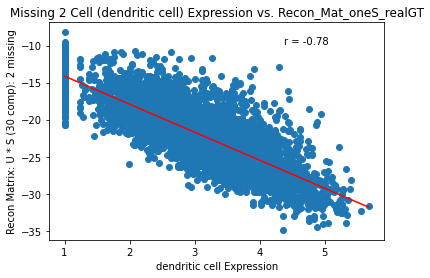

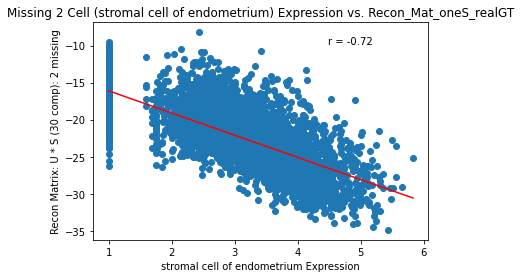

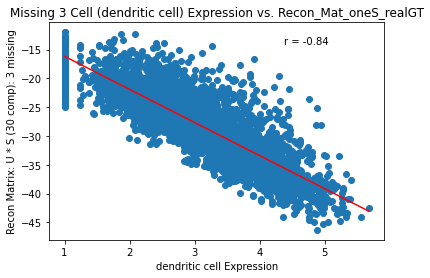

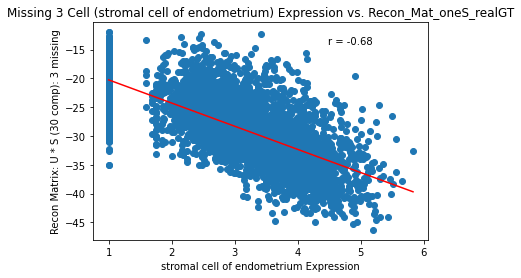

...

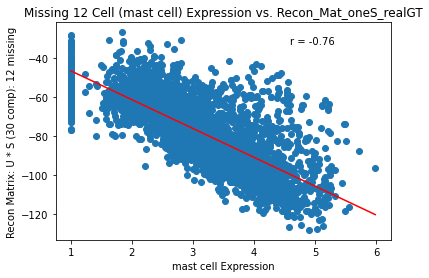

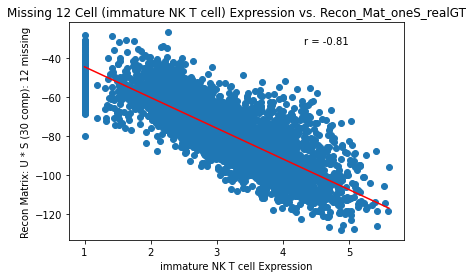

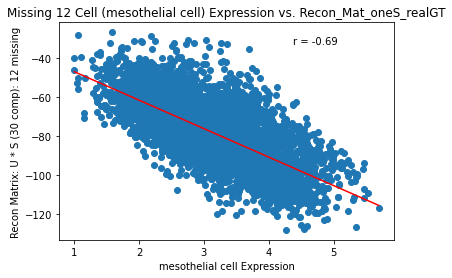

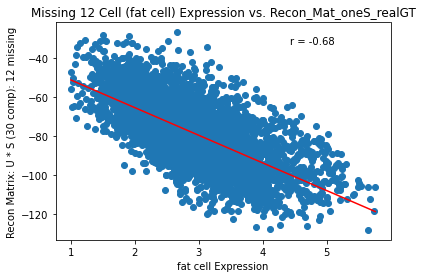

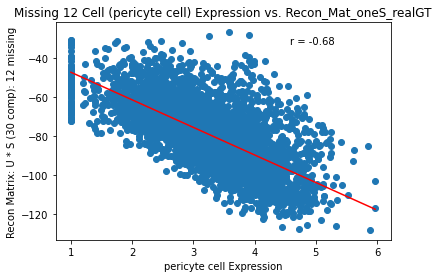

In [ ]:
#Recon_Mat_hc with missing cell expression
for num in num_missing_cells[1:]:
    mat = missing_cell_exp[num]
    for cell_number in mat.columns:
        x = mat[cell_number].values
        for col in Recon_Mat_oneS_realGT[num].columns[0:S_val_elbow[num]]:
            y = Recon_Mat_oneS_realGT[num][col].values
            plt.scatter(x, y)
            plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
            r, p = stats.pearsonr(x, y)
            plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')
        plt.title(f"Missing {num} Cell ({cell_number}) Expression vs. Recon_Mat_oneS_realGT")
        plt.xlabel(f"{cell_number} Expression")
        plt.ylabel(f"Recon Matrix: U * S ({num_SVs} comp): {num} missing")
        plt.show()

In [ ]:
Recon_Mat_oneS_realGT[1]

,0
0,-21.900249
1,-16.402523
2,-12.736117
3,-15.356540
4,-6.805602
...,...
4313,-16.276202
4314,-14.799130
4315,-10.916278
4316,-10.017521


In [ ]:
Recon_Mat_oneS_realGT[2]

,0
0,-31.659276
1,-22.781767
2,-19.220712
3,-23.533649
4,-13.189217
...,...
4313,-20.160002
4314,-18.715233
4315,-16.629762
4316,-15.136809


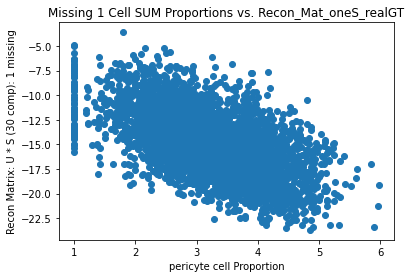

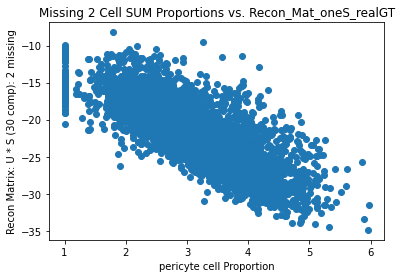

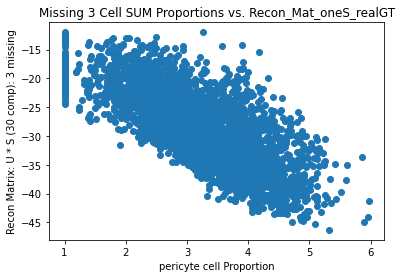

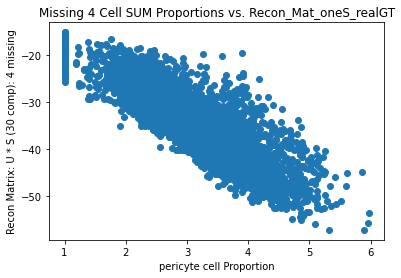

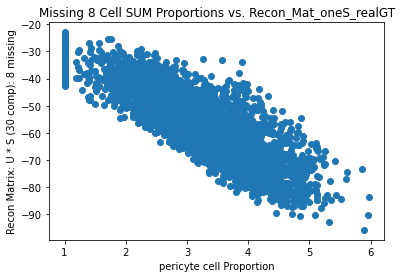

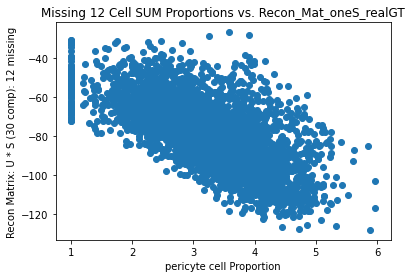

In [ ]:
#Recon_Mat_hc with missing cell expression
for num in num_missing_cells[1:]:
    mat = missing_cell_prop[num].sum(axis=1).values
    y = Recon_Mat_oneS_realGT[num].values
    plt.scatter(x, y)
    plt.title(f"Missing {num} Cell SUM Proportions vs. Recon_Mat_oneS_realGT")
    plt.xlabel(f"{cell_number} Proportion")
    plt.ylabel(f"Recon Matrix: U * S ({num_SVs} comp): {num} missing")
    plt.show()

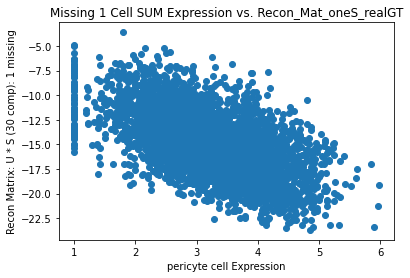

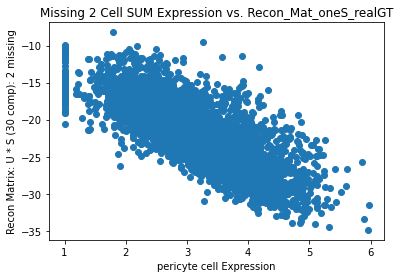

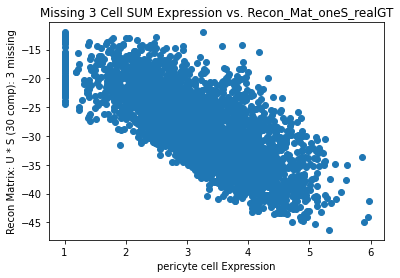

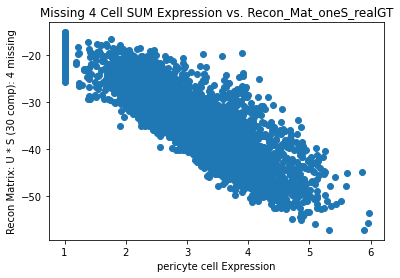

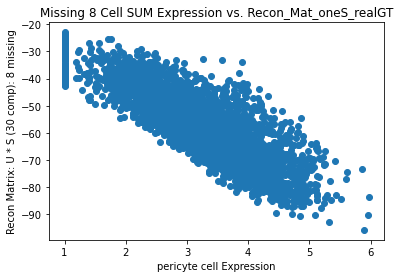

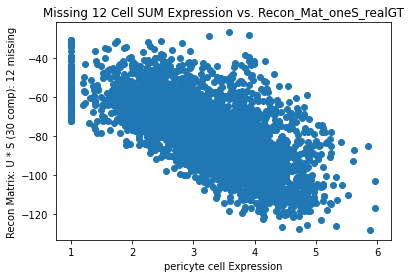

In [ ]:
#Recon_Mat_hc with missing cell expression
for num in num_missing_cells[1:]:
    mat = missing_cell_exp[num].sum(axis=1).values
    y = Recon_Mat_oneS_realGT[num].values
    plt.scatter(x, y)
    plt.title(f"Missing {num} Cell SUM Expression vs. Recon_Mat_oneS_realGT")
    plt.xlabel(f"{cell_number} Expression")
    plt.ylabel(f"Recon Matrix: U * S ({num_SVs} comp): {num} missing")
    plt.show()

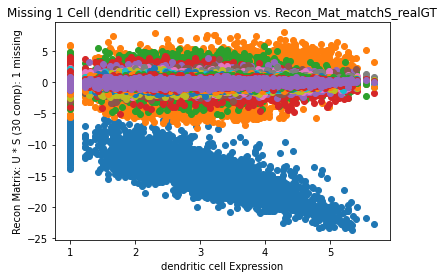

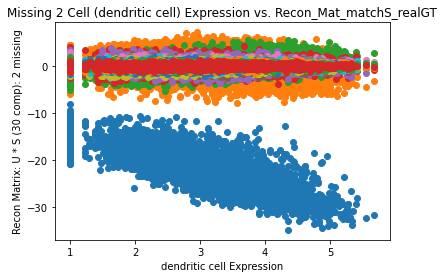

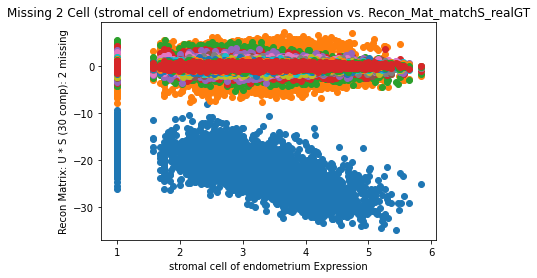

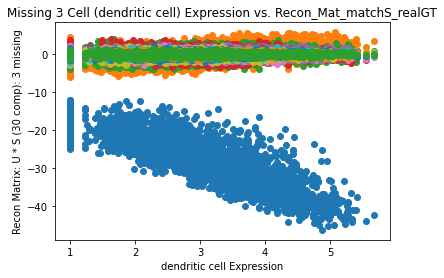

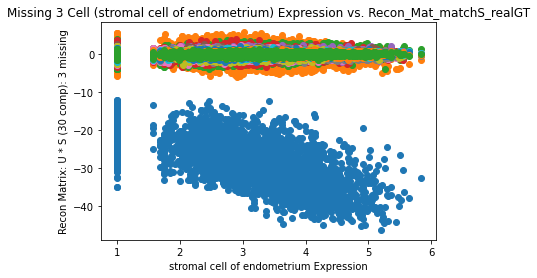

...

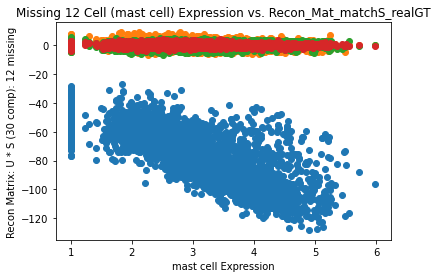

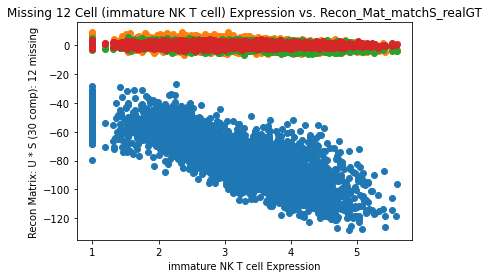

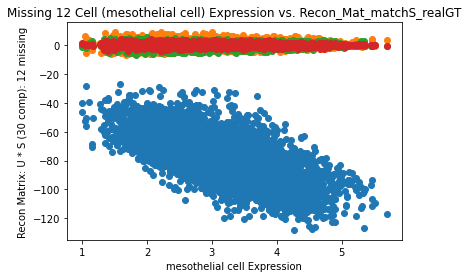

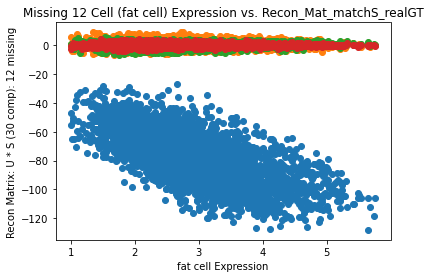

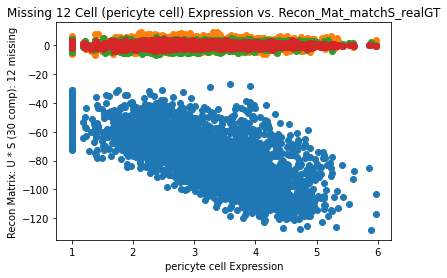

In [ ]:
#Recon_Mat_hc with missing cell expression
for num in num_missing_cells[1:]:
    mat = missing_cell_exp[num]
    for cell_number in mat.columns:
        x = mat[cell_number].values
        for col in Recon_Mat_matchS_realGT[num].columns[0:S_val_elbow[num]]:
            y = Recon_Mat_matchS_realGT[num][col].values
            plt.scatter(x, y)
        plt.title(f"Missing {num} Cell ({cell_number}) Expression vs. Recon_Mat_matchS_realGT")
        plt.xlabel(f"{cell_number} Expression")
        plt.ylabel(f"Recon Matrix: U * S ({num_SVs} comp): {num} missing")
        plt.show()

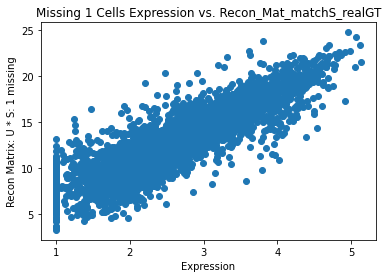

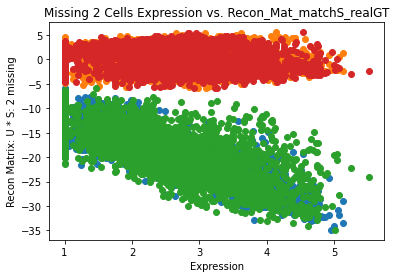

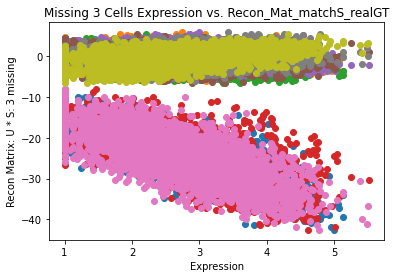

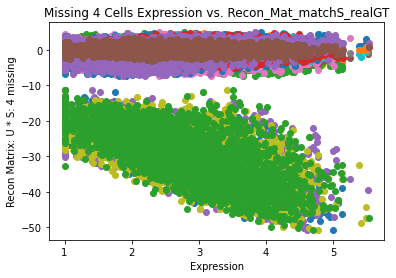

In [ ]:
#Recon_Mat_hc with missing cell expression
for num in num_missing_cells[1:5]:
    mat = missing_cell_exp[num]
    cell_number = 0
    for cell_number in mat.columns:
        column = mat[cell_number]
        x = column
        for col in Recon_Mat_matchS_realGT[num].columns[0:num]:
            y = Recon_Mat_matchS_realGT[num][col]
            plt.scatter(x, y)
        plt.title(f"Missing {num} Cells Expression vs. Recon_Mat_matchS_realGT")
        plt.xlabel(f"Expression")
        plt.ylabel(f"Recon Matrix: U * S: {num} missing")
    plt.show()

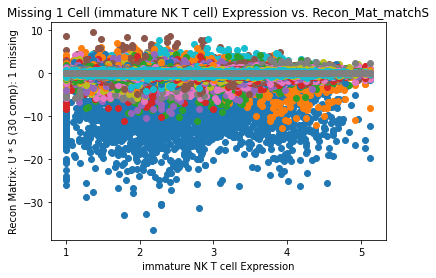

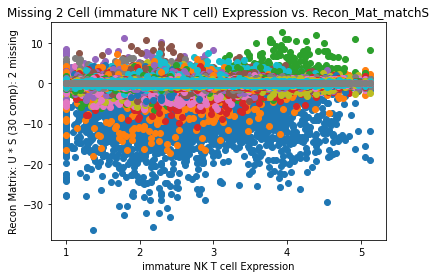

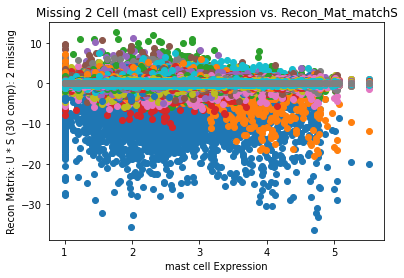

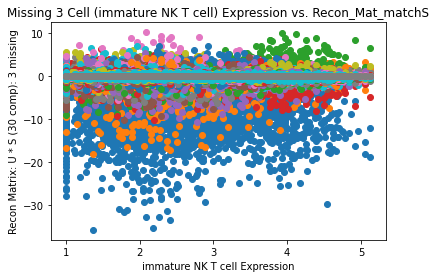

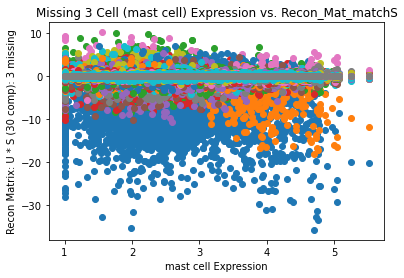

...

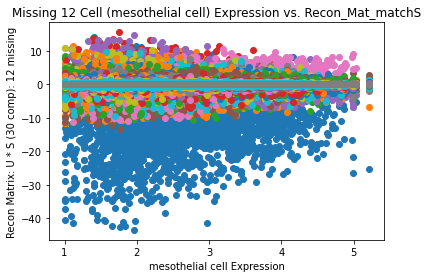

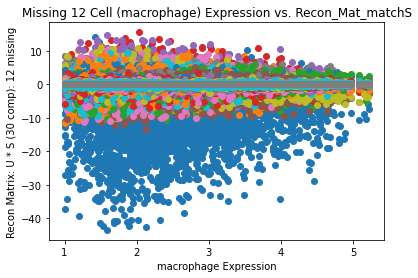

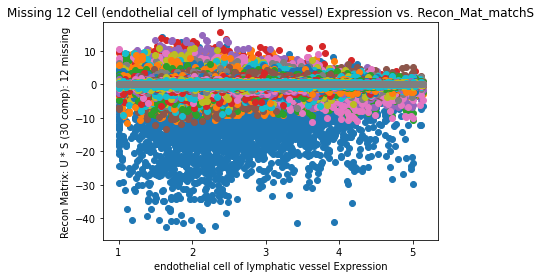

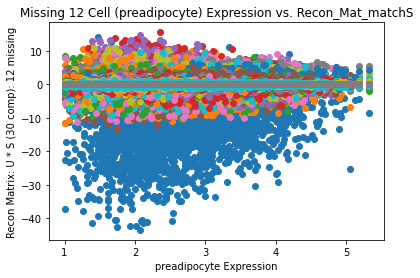

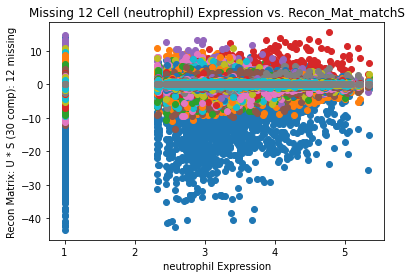

In [ ]:
#Recon_Mat_hc with missing cell expression
for num in num_missing_cells[1:]:
    mat = missing_cell_exp[num]
    cell_number = 0
    for cell_number in mat.columns:
        column = mat[cell_number]
        x = column
        for col in Recon_Mat_matchS[num].columns:
            y = Recon_Mat_matchS[num][col]
            plt.scatter(x, y)
        plt.title(f"Missing {num} Cell ({cell_number}) Expression vs. Recon_Mat_matchS")
        plt.xlabel(f"{cell_number} Expression")
        plt.ylabel(f"Recon Matrix: U * S ({num_SVs} comp): {num} missing")
        plt.show()

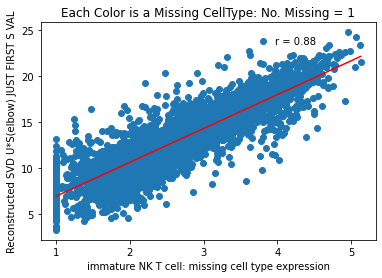

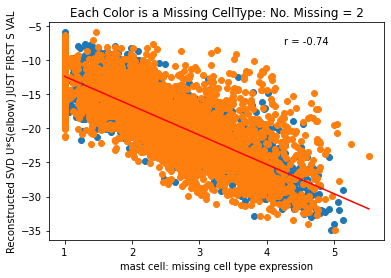

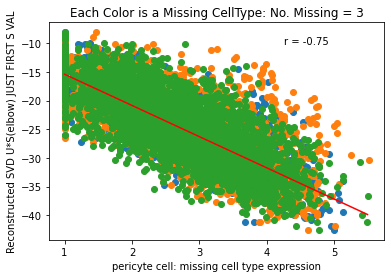

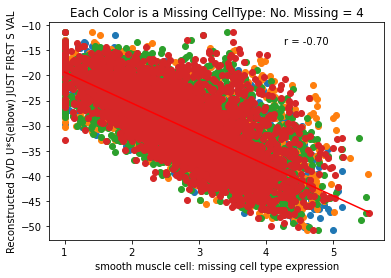

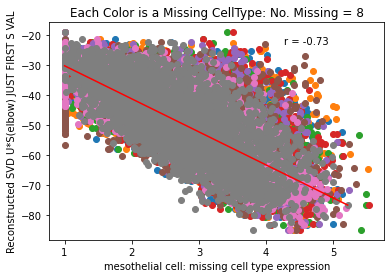

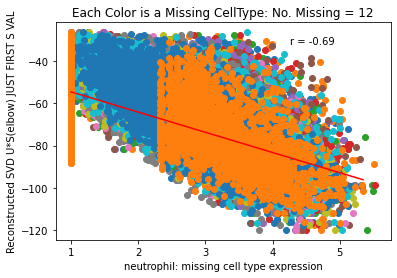

In [ ]:
for num in num_missing_cells[1:]:
    for col in missing_cell_exp[num].columns:
        x = missing_cell_exp[num][col]
        y = Recon_Mat_matchS_realGT[num][0]
        plt.scatter(x,y)

        plt.title(f'Each Color is a Missing CellType: No. Missing = {num}')
        plt.xlabel(f'{col}: missing cell type expression')
        plt.ylabel(f"Reconstructed SVD U*S(elbow) JUST FIRST S VAL")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

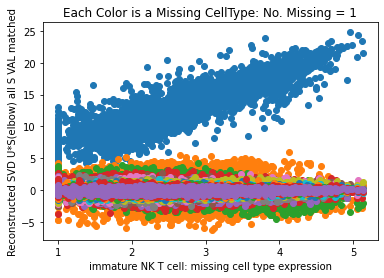

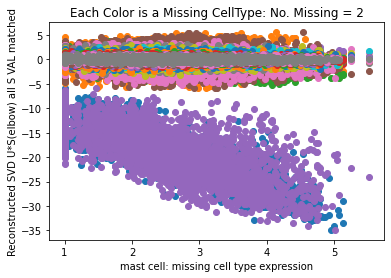

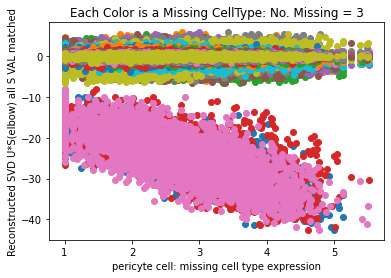

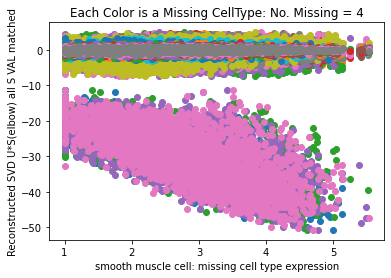

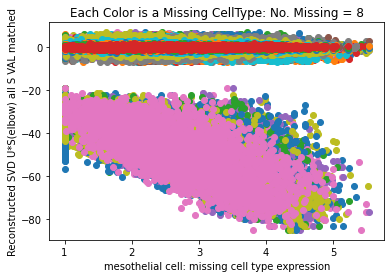

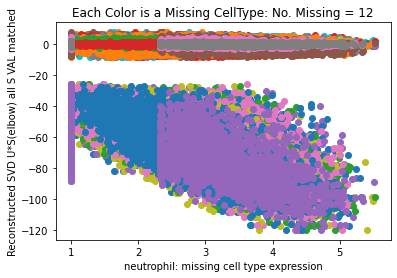

In [ ]:
for num in num_missing_cells[1:]:
    for col in missing_cell_exp[num].columns:
        x = missing_cell_exp[num][col]
        for column in Recon_Mat_matchS_realGT[num].columns:
            y = Recon_Mat_matchS_realGT[num][column]
            plt.scatter(x,y)
        plt.title(f'Each Color is a Missing CellType: No. Missing = {num}')
        plt.xlabel(f'{col}: missing cell type expression')
        plt.ylabel(f"Reconstructed SVD U*S(elbow) all S VAL matched")
    plt.show()

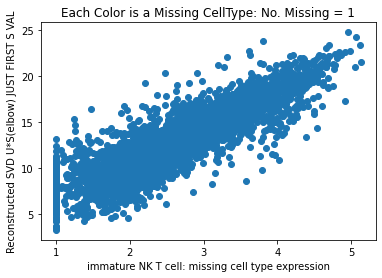

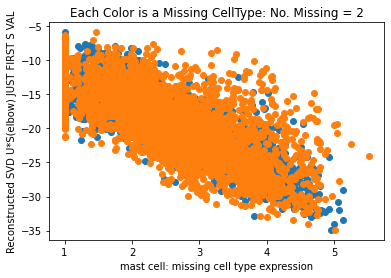

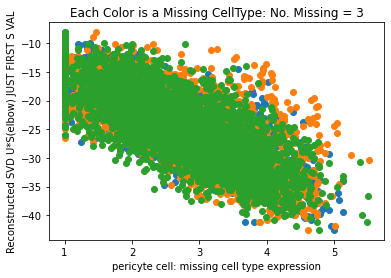

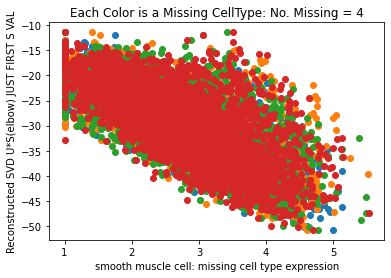

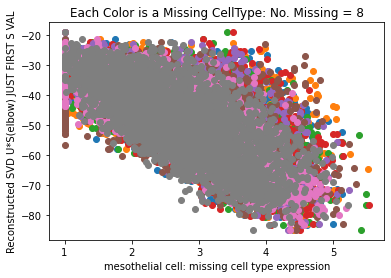

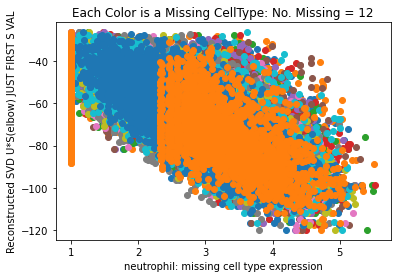

In [ ]:
for num in num_missing_cells[1:]:
    for col in missing_cell_exp[num].columns:
        x = missing_cell_exp[num][col]
        y = Recon_Mat_matchS_realGT[num][0]
        plt.scatter(x,y)
        plt.title(f'Each Color is a Missing CellType: No. Missing = {num}')
        plt.xlabel(f'{col}: missing cell type expression')
        plt.ylabel(f"Reconstructed SVD U*S(elbow) JUST FIRST S VAL")
    plt.show()

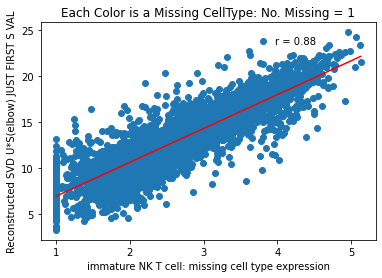

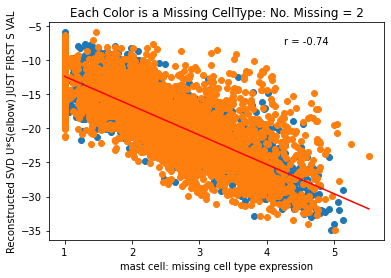

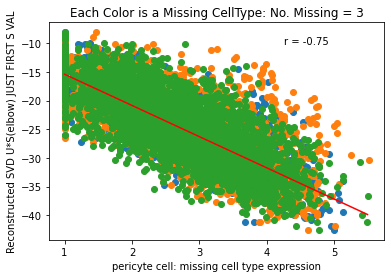

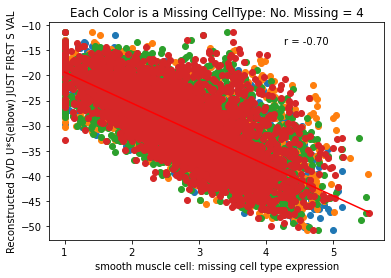

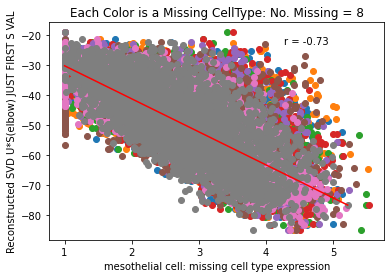

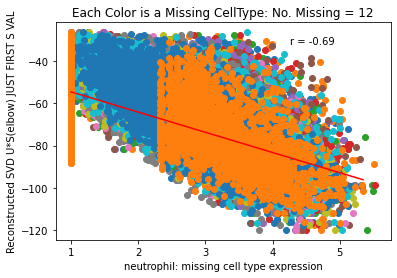

In [ ]:
for num in num_missing_cells[1:]:
    for col in missing_cell_exp[num].columns:
        x = missing_cell_exp[num][col]
        y = Recon_Mat_matchS_realGT[num][0]
        plt.scatter(x,y)

    plt.title(f'Each Color is a Missing CellType: No. Missing = {num}')
    plt.xlabel(f'{col}: missing cell type expression')
    plt.ylabel(f"Reconstructed SVD U*S(elbow) JUST FIRST S VAL")
    plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
    r, p = stats.pearsonr(x, y)
    plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
    plt.show()

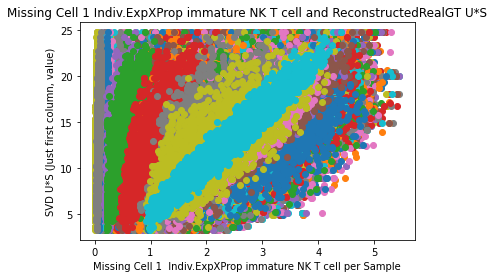

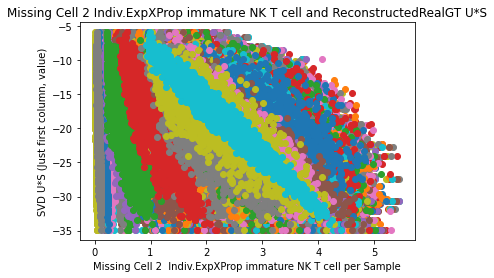

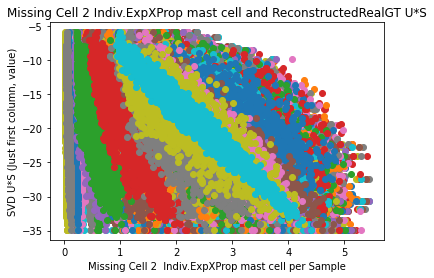

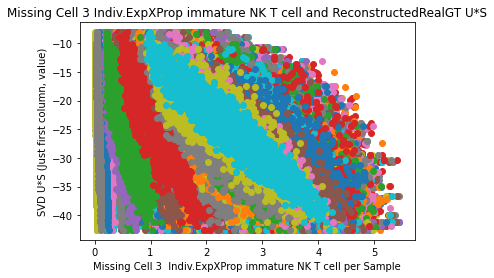

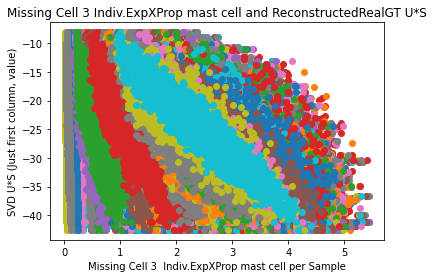

...

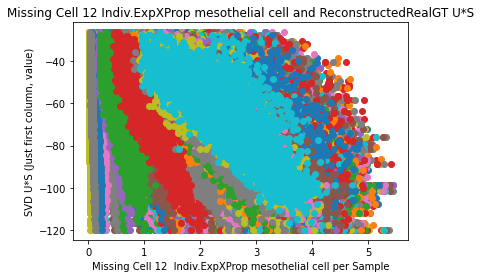

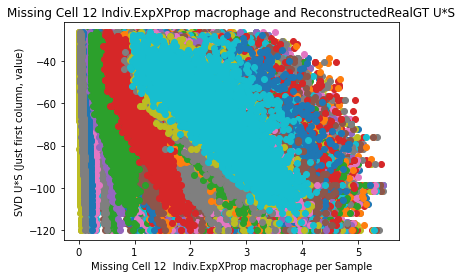

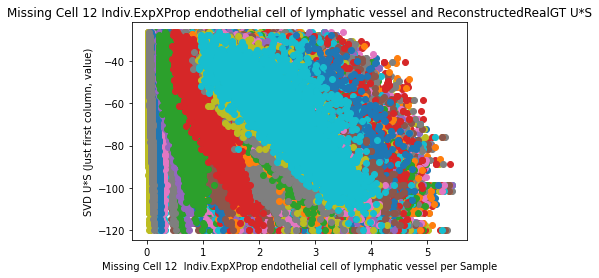

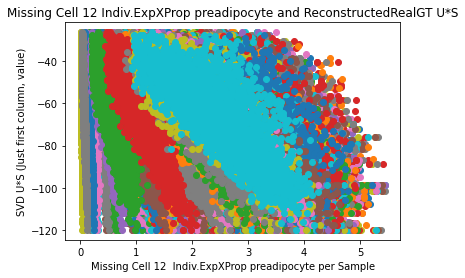

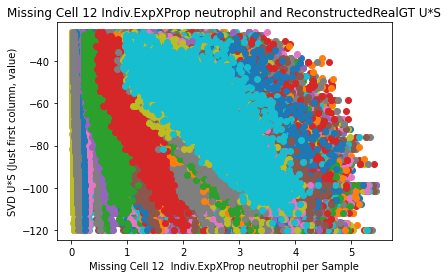

In [ ]:
for num in num_missing_cells[1:]:
    x_tot = ex_prop_individual[num]
    for cell in x_tot:
        x_all = x_tot[cell]
        for index, cells in x_all.iterrows():
            x = cells.values
            y = Recon_Mat_matchS_realGT[num][0].values
            plt.scatter(x,y)
            plt.title(f"Missing Cell {num} Indiv.ExpXProp {cell} and ReconstructedRealGT U*S")
            plt.xlabel(f"Missing Cell {num}  Indiv.ExpXProp {cell} per Sample")
            plt.ylabel(f"SVD U*S (Just first column, value)")
        # plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        # r, p = stats.pearsonr(x, y)
        # plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()        

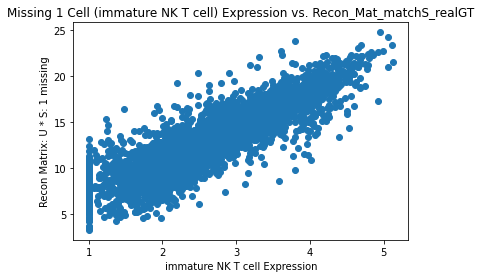

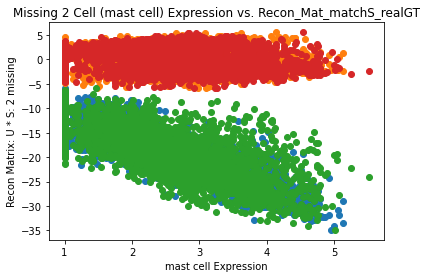

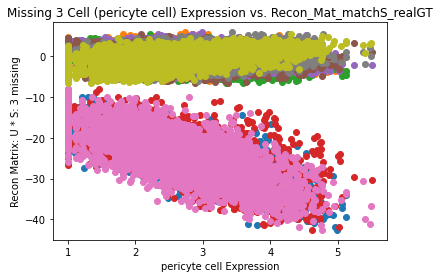

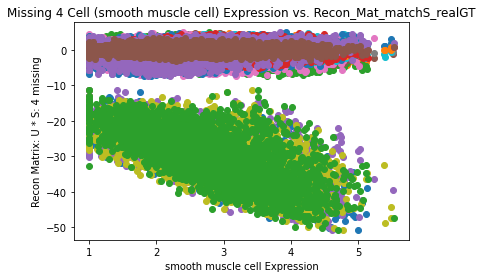

In [ ]:
#Recon_Mat_hc with missing cell expression
for num in num_missing_cells[1:5]:
    mat = missing_cell_exp[num]
    cell_number = 0
    for cell_number in mat.columns:
        column = mat[cell_number]
        x = column
        for col in Recon_Mat_matchS_realGT[num].columns[0:num]:
            y = Recon_Mat_matchS_realGT[num][col]
            plt.scatter(x, y)
        plt.title(f"Missing {num} Cell ({cell_number}) Expression vs. Recon_Mat_matchS_realGT")
        plt.xlabel(f"{cell_number} Expression")
        plt.ylabel(f"Recon Matrix: U * S: {num} missing")
    plt.show()

**PCA**

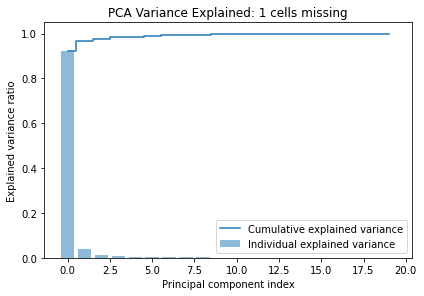

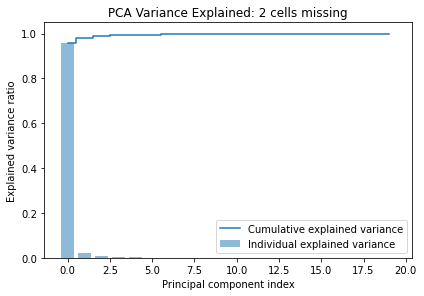

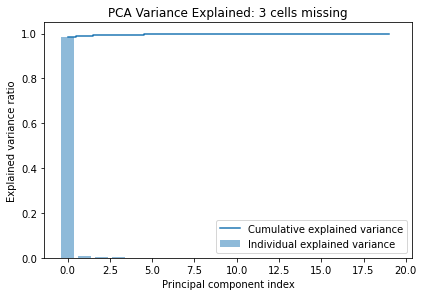

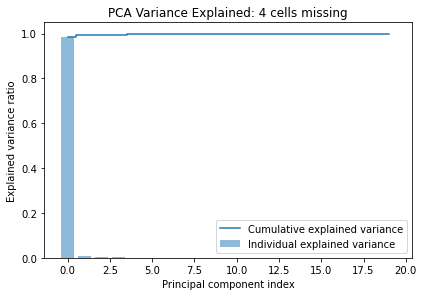

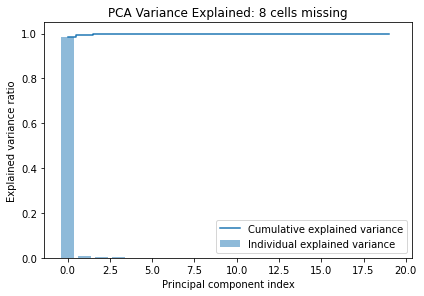

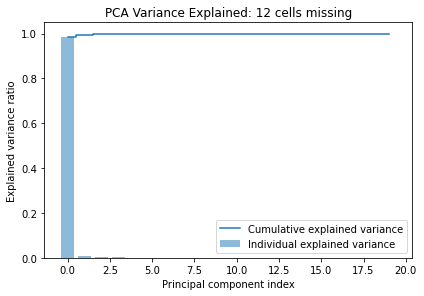

In [ ]:
pca_all = dict()
for num in num_cells_missing[1:]:
    df = residuals_realgt[num]
    fit = PCA(n_components=20)
    pca_results = fit.fit_transform(df.values)

    exp_var_pca = fit.explained_variance_ratio_
    cum_sum_eigenvalues = np.cumsum(exp_var_pca)

    ## plot variance explained
    plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', label='Individual explained variance')
    plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
    plt.ylabel('Explained variance ratio')
    plt.xlabel('Principal component index')
    plt.legend(loc='best')
    plt.tight_layout()
    plt.title(f"PCA Variance Explained: {num} cells missing")
    plt.show()
    pca_all[num] = pd.DataFrame(pca_results)

In [ ]:
for num in num_missing_cells[1:]:
    for cell in ex_prop_individual[num]:
        x_all = ex_prop_individual[num][cell]
        for index, row in x_all.iterrows():
            x = row.values
            y = Recon_Mat_oneS_realGT[num][0].values
            plt.scatter(x,y)
        plt.title(f'No. Missing {num}: Each Color is One Sample, Each Point is one Gene')
        plt.xlabel(f'{cell} missing cell type expression X props')
        plt.ylabel(f"Reconstructed SVD U*oneS")
        # plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)), color = "red")
        # r, p = stats.pearsonr(x, y)
        # plt.annotate('r = {:.2f}'.format(r), xy=(0.7, 0.9), xycoords='axes fraction')    
        plt.show()